In [2]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from pyhdf.SD import SD, SDC
from osgeo import gdal

In [35]:
import tensorflow as tf

In [38]:
from sklearn.cluster import  AgglomerativeClustering

In [34]:
from matplotlib import patches as mpl_patches
from matplotlib.colors import Colormap

In [56]:
import copy

# Compare MOD09 and MOD06

## MOD 09 

In [3]:
datadir = "/home/tkurihana/scratch-midway2/data/"

In [5]:
mod09_path = datadir+'GEE/2017-01-01_MOD09GA_closed-cell.tif'

In [6]:
mod09_data = gdal.Open(mod09_path)
mod09_data = mod09_data.ReadAsArray()

In [7]:
mod09 = np.rollaxis(mod09_data, 0, 3)

 Shaope  (2525, 4231, 7)


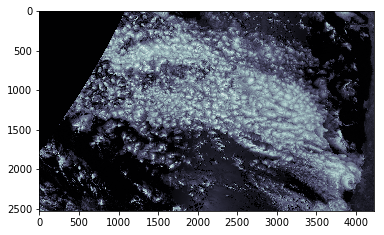

In [8]:
# check for plt
print(" Shape ", mod09.shape )
plt.figure()
plt.imshow(mod09[:,:,0], cmap='bone')
plt.show()

In [16]:
# check lat-lon info
mod09_info = gdal.Info(mod09_path)

In [17]:
mod09_info

'Driver: GTiff/GeoTIFF\nFiles: /home/tkurihana/scratch-midway2/data/GEE/2017-01-01_MOD09GA_closed-cell.tif\nSize is 4231, 2525\nCoordinate System is:\nGEOGCS["WGS 84",\n    DATUM["WGS_1984",\n        SPHEROID["WGS 84",6378137,298.257223563,\n            AUTHORITY["EPSG","7030"]],\n        AUTHORITY["EPSG","6326"]],\n    PRIMEM["Greenwich",0],\n    UNIT["degree",0.0174532925199433],\n    AUTHORITY["EPSG","4326"]]\nOrigin = (-89.000586774141595,-17.997746717334614)\nPixel Size = (0.004491576420598,-0.004491576420598)\nMetadata:\n  AREA_OR_POINT=Area\nImage Structure Metadata:\n  COMPRESSION=LZW\n  INTERLEAVE=PIXEL\nCorner Coordinates:\nUpper Left  ( -89.0005868, -17.9977467) ( 89d 0\' 2.11"W, 17d59\'51.89"S)\nLower Left  ( -89.0005868, -29.3389772) ( 89d 0\' 2.11"W, 29d20\'20.32"S)\nUpper Right ( -69.9967269, -17.9977467) ( 69d59\'48.22"W, 17d59\'51.89"S)\nLower Right ( -69.9967269, -29.3389772) ( 69d59\'48.22"W, 29d20\'20.32"S)\nCenter      ( -79.4986569, -23.6683619) ( 79d29\'55.16"W, 

In [21]:
!gdalinfo "/home/tkurihana/scratch-midway2/data/GEE/2017-01-01_MOD09GA_closed-cell.tif"

Driver: GTiff/GeoTIFF
Files: /home/tkurihana/scratch-midway2/data/GEE/2017-01-01_MOD09GA_closed-cell.tif
Size is 4231, 2525
Coordinate System is:
GEOGCS["WGS 84",
    DATUM["WGS_1984",
        SPHEROID["WGS 84",6378137,298.257223563,
            AUTHORITY["EPSG","7030"]],
        AUTHORITY["EPSG","6326"]],
    PRIMEM["Greenwich",0],
    UNIT["degree",0.0174532925199433],
    AUTHORITY["EPSG","4326"]]
Origin = (-89.000586774141595,-17.997746717334614)
Pixel Size = (0.004491576420598,-0.004491576420598)
Metadata:
  AREA_OR_POINT=Area
Image Structure Metadata:
  COMPRESSION=LZW
  INTERLEAVE=PIXEL
Corner Coordinates:
Upper Left  ( -89.0005868, -17.9977467) ( 89d 0' 2.11"W, 17d59'51.89"S)
Lower Left  ( -89.0005868, -29.3389772) ( 89d 0' 2.11"W, 29d20'20.32"S)
Upper Right ( -69.9967269, -17.9977467) ( 69d59'48.22"W, 17d59'51.89"S)
Lower Right ( -69.9967269, -29.3389772) ( 69d59'48.22"W, 29d20'20.32"S)
Center      ( -79.4986569, -23.6683619) ( 79d29'55.16"W, 23d40' 6.10"S)
Band 1 Block=256x25

## MOD06

In [9]:
mod06_path = datadir+'MOD06/03_onefile'

In [13]:
def decoder(filename, subject='Cloud_Optical_Thickness'):
    ifile = SD(filename, SDC.READ)
    #ds = ifile.select('{subject}')
    ds = ifile.select('Cloud_Optical_Thickness')
    print(" subject : %s " % subject)
    ds = ds.get()
    data = ds[:].astype(np.float64)
    print("data shape", data.shape)
    return data

In [14]:
filename=mod06_path+'/MOD06_L2.A2017001.mosaic.061.2019007011012.mccs_000501293078.Cloud_Optical_Thickness.hdf'
mod06_data = decoder(filename, subject='Cloud_Optical_Thickness')

 subject : Cloud_Optical_Thickness 
data shape (5714, 5332)


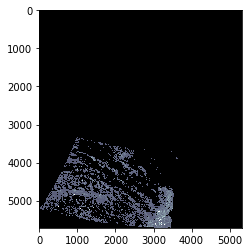

In [15]:
plt.figure()
plt.imshow(mod06_data, cmap='bone')
plt.show()

## MOD06-tif

In [22]:
mod06_tif_dir = '/home/tkurihana/scratch-midway2/data/MOD06/04'
inputfile = "MOD06_L2.A2017001.mosaic.061.2019009151522.sggs_000501293979.Cloud_Optical_Thickness-Cloud_Optical_Thickness.tif"
mod06_swath =  gdal.Open(mod06_tif_dir+"/"+inputfile)

In [23]:
mod06_swath_data = mod06_swath.ReadAsArray()

In [24]:
mod06_swath_data.shape

(1259, 2117)

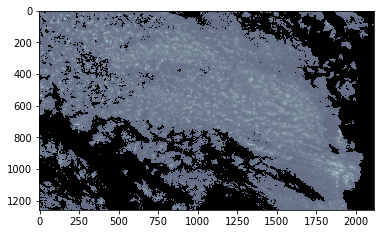

In [25]:
plt.figure()
plt.imshow(mod06_swath_data, cmap='bone')

## Show 2 files in same graph

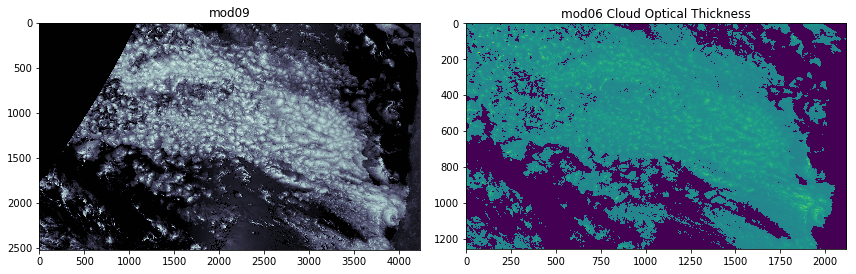

In [29]:
fig = plt.figure(figsize=(12,9))
ax = plt.subplot(1,2,1)
plt.imshow(mod09[:,:,0], cmap='bone')
ax.set_title('mod09')
ax = plt.subplot(1,2,2)
plt.imshow(mod06_swath_data)
ax.set_title('mod06 Cloud Optical Thickness')
plt.colorbar()
fig.tight_layout()
plt.show()

## Other variables

In [31]:
def _load_tif_data(inputfilename):
    mod06_tif_dir = '/home/tkurihana/scratch-midway2/data/MOD06/04'
    basename = 'MOD06_L2.A2017001.mosaic.061.2019009151522.sggs_000501293979.'
    mod06_swath =  gdal.Open(mod06_tif_dir+"/"+basename+inputfilename+'.tif')
    print('variable : %s' % inputfilename )
    return mod06_swath.ReadAsArray()

In [32]:
filelist=[
    "Cloud_Phase_Infrared-Cloud_Phase_Infrared",
    "Cloud_Effective_Radius-Cloud_Effective_Radius",
    "Cloud_Water_Path-Cloud_Water_Path",
    "Cirrus_Reflectance-Cirrus_Reflectance",
    "Cloud_Top_Temperature-Cloud_Top_Temperature",
    "Cloud_Top_Pressure-Cloud_Top_Pressure",
    "Cloud_Effective_Emissivity-Cloud_Effective_Emissivity",
    "Cloud_Top_Height-Cloud_Top_Height"
]

variable : Cloud_Phase_Infrared-Cloud_Phase_Infrared


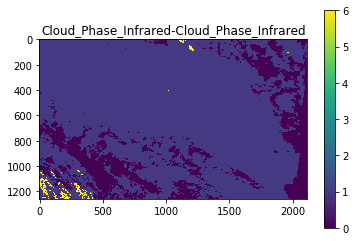

variable : Cloud_Effective_Radius-Cloud_Effective_Radius


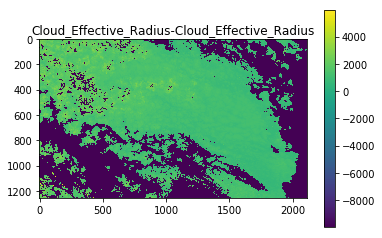

variable : Cloud_Water_Path-Cloud_Water_Path


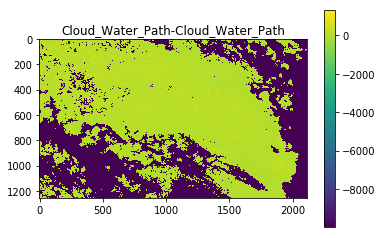

variable : Cirrus_Reflectance-Cirrus_Reflectance


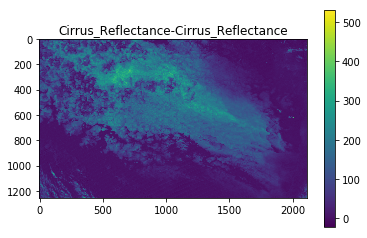

variable : Cloud_Top_Temperature-Cloud_Top_Temperature


/home/tkurihana/.conda/envs/py3501/lib/python3.6/site-packages/matplotlib/transforms.py:2943: RuntimeWarning: overflow encountered in short_scalars
  elif vmax - vmin <= maxabsvalue * tiny:


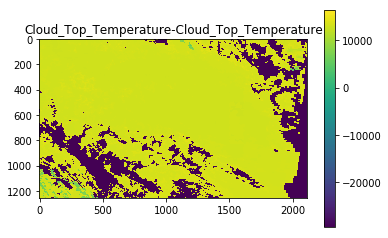

variable : Cloud_Top_Pressure-Cloud_Top_Pressure


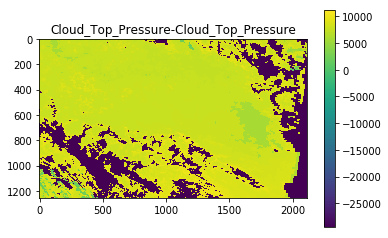

variable : Cloud_Effective_Emissivity-Cloud_Effective_Emissivity


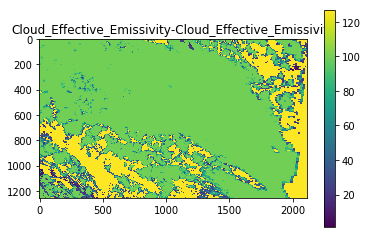

variable : Cloud_Top_Height-Cloud_Top_Height


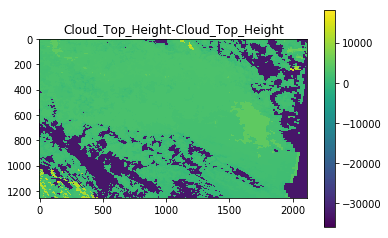

In [33]:
for ifile in filelist:
    _data = _load_tif_data(ifile)
    plt.figure()
    plt.title(str(ifile))
    plt.imshow(_data)
    plt.colorbar()
    plt.show()

## Classification

In [36]:
model_dir = "/home/tkurihana/clouds/output/m9-22_oceans/"
ENCODER_DEF=model_dir+'encoder.json'
ENCODER_WEIGHTS=model_dir+'encoder.h5'
with open(ENCODER_DEF,"r") as f:
    encoder = tf.keras.models.model_from_json(f.read())
encoder.load_weights(ENCODER_WEIGHTS)

/home/tkurihana/.conda/envs/py3501/lib/python3.6/site-packages/tensorflow/python/keras/layers/core.py:791: UserWarning: models is not loaded, but a Lambda layer uses it. It may cause errors.
  , UserWarning)


In [42]:
SHAPE = 128, 128, 7

In [60]:
# Color scheme by Ricardo
colors = ["#833f2c",
"#016dec",
"#5cb925",
"#e125a2",
"#2f8900",
"#ff95f9",
"#009650",
"#bb0075",
"#8bd890",
"#d30063",
"#00c7b1",
"#e63e2c",
"#029ebe",
"#f0ae00",
"#b98fff",
"#e1c54c",
"#6e3c92",
"#7ad8b4",
"#ff5655",
"#375c16",
"#ff5677",
"#75481c",
"#ffa2d2",
"#9b280d",
"#ffa47a",
"#952f23",
"#ff804b"]

In [67]:
def _gen_patches(img, stride=128, size=128):
    # generate swath again
    swath = img   
    swath_mean = swath.mean(axis=(0,1))
    swath_std = swath.std(axis=(0,1))
    patches = []

    stride = stride
    patch_size = size

    patches = []
    for i in range(0, swath.shape[0], stride):
        row = []
        for j in range(0, swath.shape[1], stride):
            if i + patch_size <= swath.shape[0] and j + patch_size <= swath.shape[1]:
                p = swath[i:i + patch_size, j:j + patch_size].astype(float)
                p -= swath_mean
                p /= swath_std
            
                row.append(p)
        if row:
            patches.append(row)
            
    return np.stack(patches)

In [40]:
def _anl_agl(encoder, patches, clusters=0):
    # clustering
    _encs = encoder.predict(patches.reshape((-1, 128, 128, 7)))
    method = AgglomerativeClustering(n_clusters=clusters)
    features = _encs.mean(axis=(1,2))
    patches_labels = method.fit_predict(features).reshape(patches.shape[:2])
    return patches_labels

In [65]:
def cluster_plotting(swath, patches,patches_labels, SHAPE, colors, ncluster=0):
    line_width = 4
    fig, a = plt.subplots(figsize=(20,20))
    plt.imshow(swath[:,:,0], cmap="bone")
    rects = []   
    for i in range(patches.shape[0]):
        for j in range(patches.shape[1]):
            a.add_patch(mpl_patches.Rectangle(
                (j * SHAPE[0] + line_width , i * SHAPE[1] + line_width ),
                width=SHAPE[0] - line_width * 2,
                height=SHAPE[1] - line_width * 2,
                linewidth=6,
                edgecolor=colors[patches_labels[i,j]],
                facecolor="none"
            ))
            centerx = SHAPE[0]*0.5*(2*j+0.5) #+1
            centery = SHAPE[1]*0.5*(2*i+1) #+1
            # add label as text
            plt.text(centerx, centery, str(patches_labels[i,j]), 
                 fontsize=20,weight='bold', 
                 color=colors[patches_labels[i,j]])
    plt.title(" ## %d cluster ## " %ncluster, fontsize=20)
    plt.show()

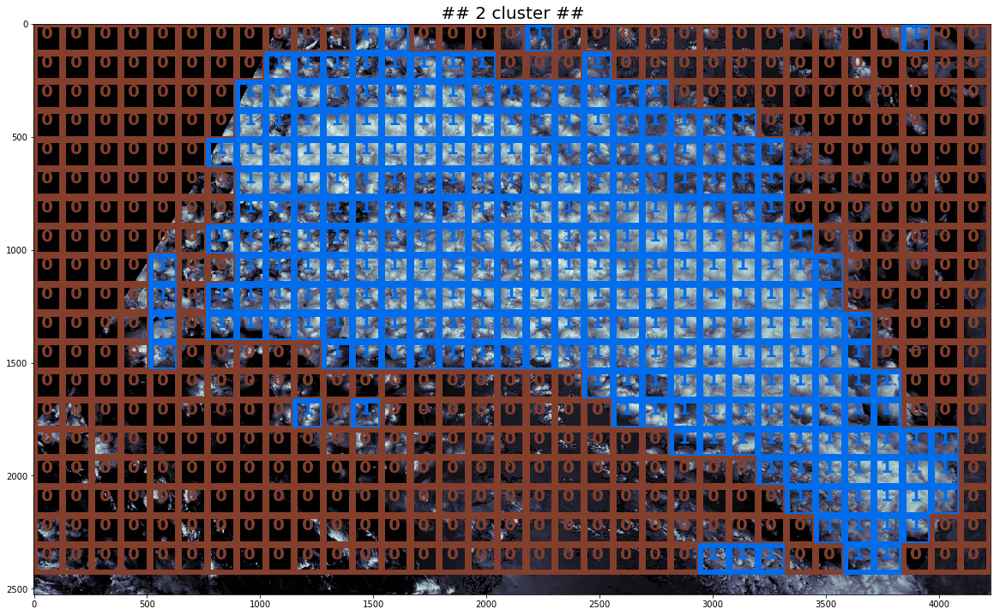

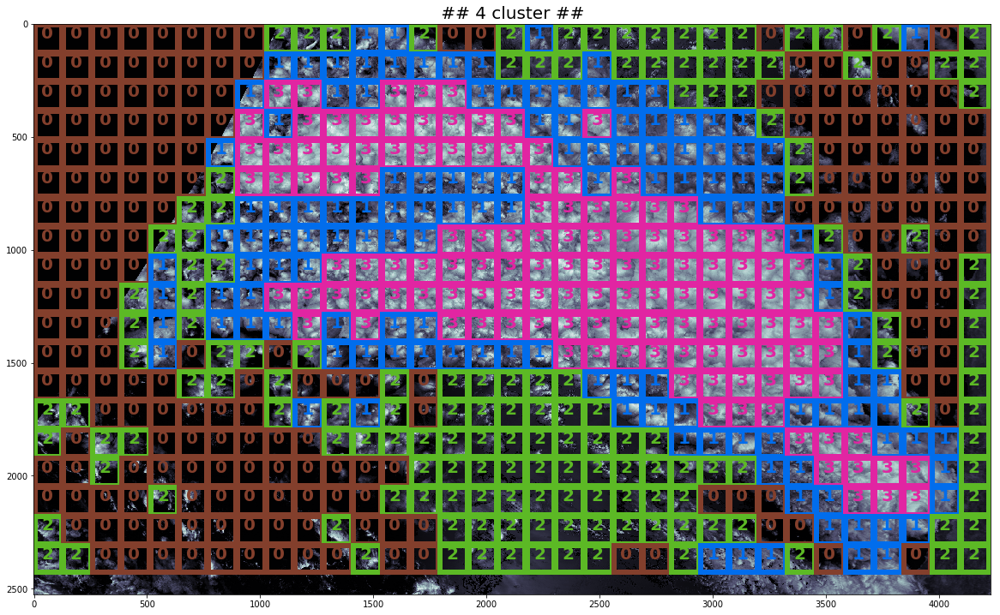

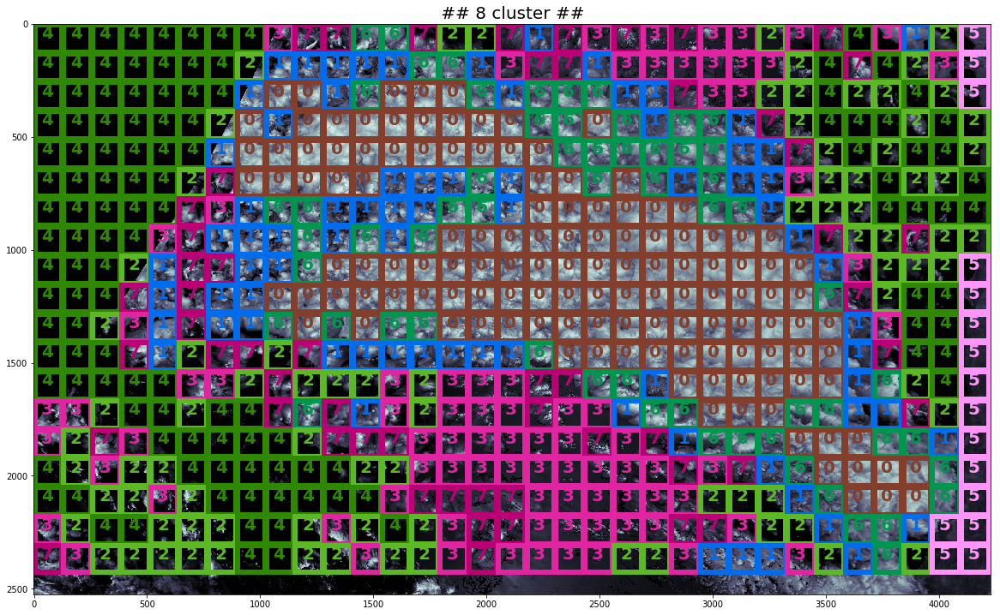

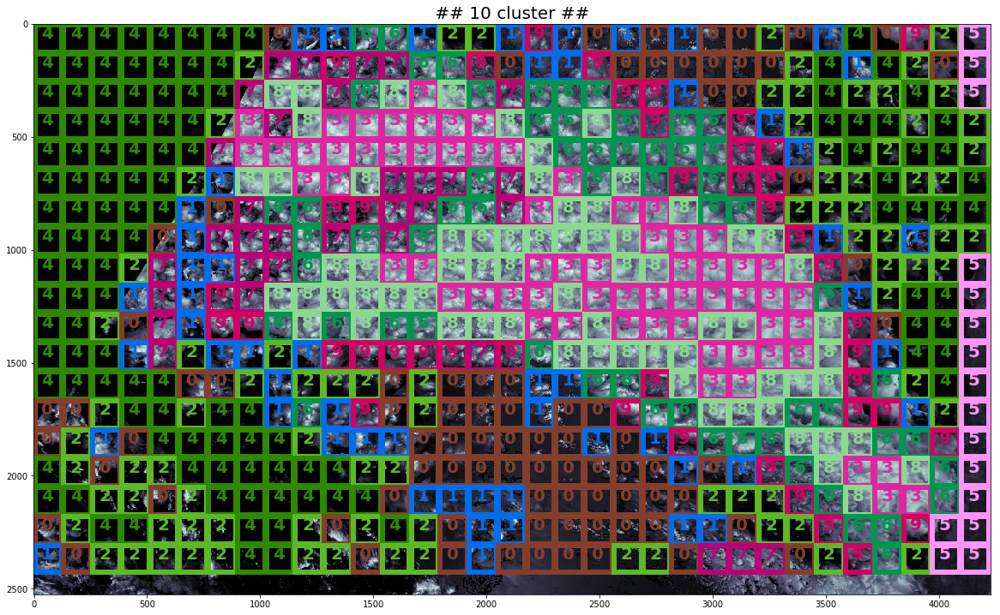

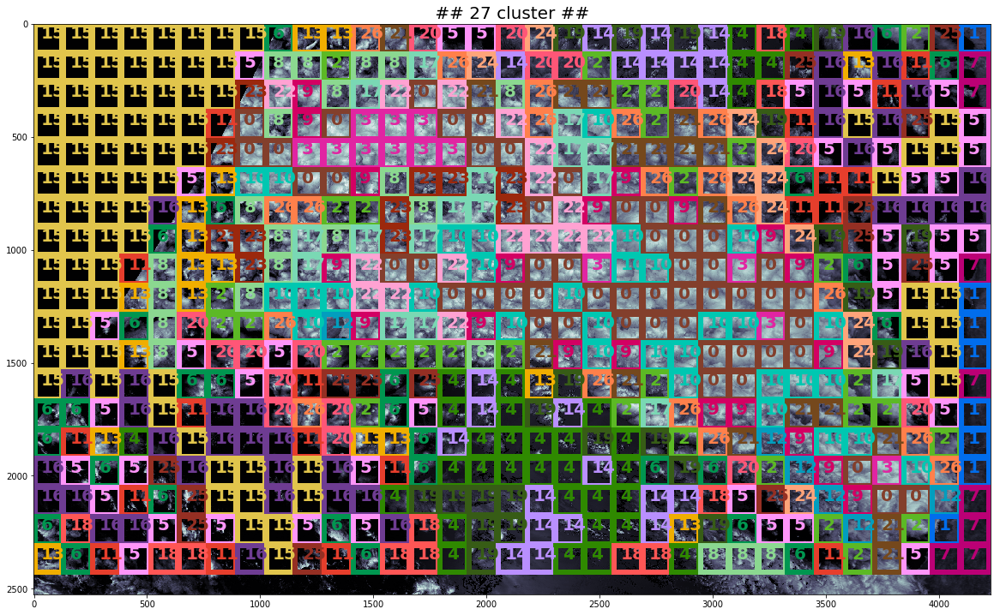

In [48]:
patches = _gen_patches(mod09)
for icluster in [2,4,8,10,27]:
    _patches_labels = _anl_agl(encoder, patches, clusters=icluster)
    cluster_plotting(mod09, patches,_patches_labels, SHAPE, colors, ncluster=icluster)

In [49]:
filelist.insert(0,"Cloud_Optical_Thickness-Cloud_Optical_Thickness")

In [57]:
def _concatenate(array, n=7):
    """ assume numpy array input """
    tmp_array = copy.deepcopy(array)
    for i in range(n-1):
        tmp_array = np.concatenate((tmp_array, array), axis=-1)
    return tmp_array

variable : Cloud_Optical_Thickness-Cloud_Optical_Thickness


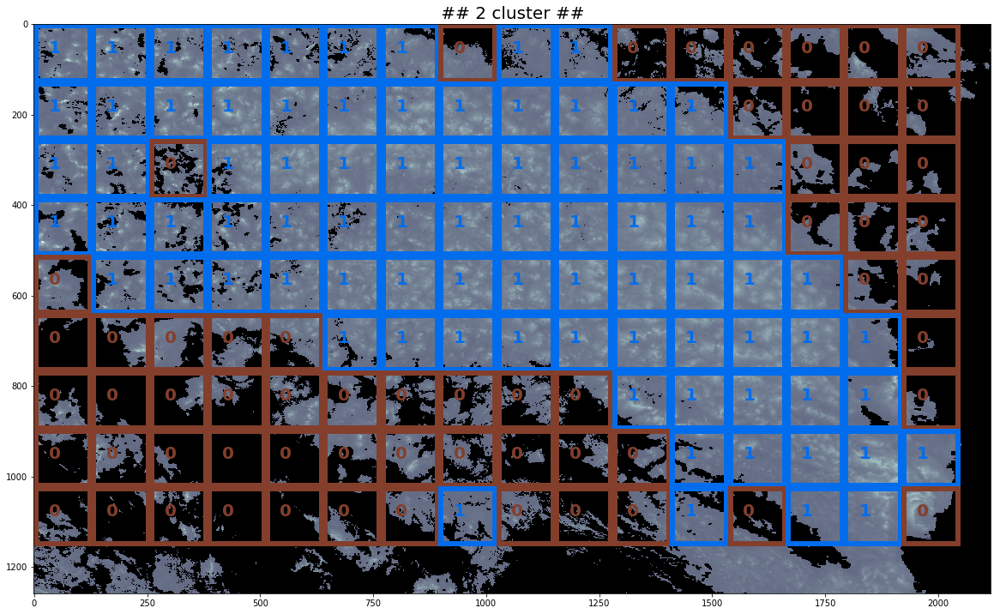

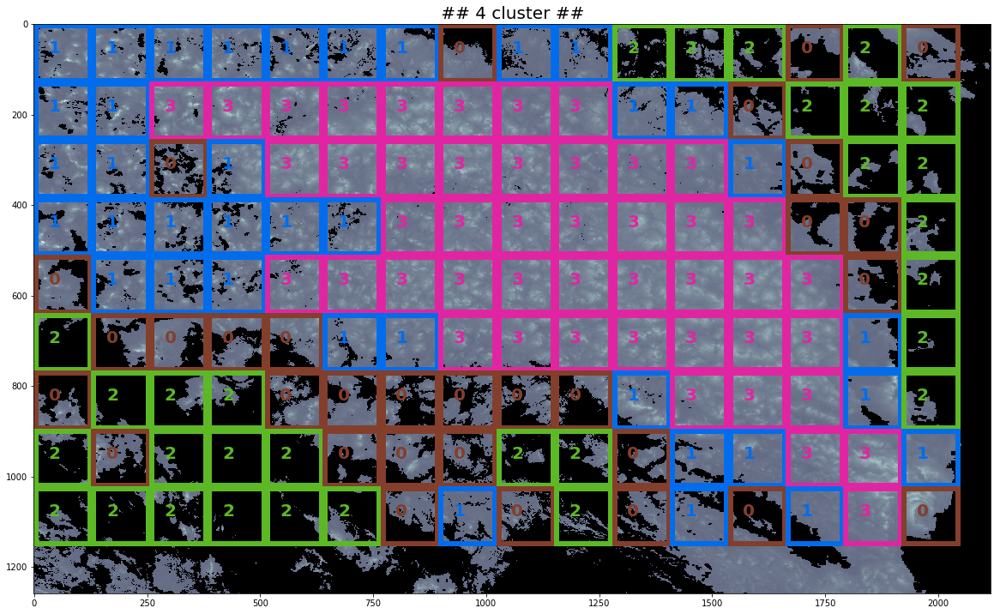

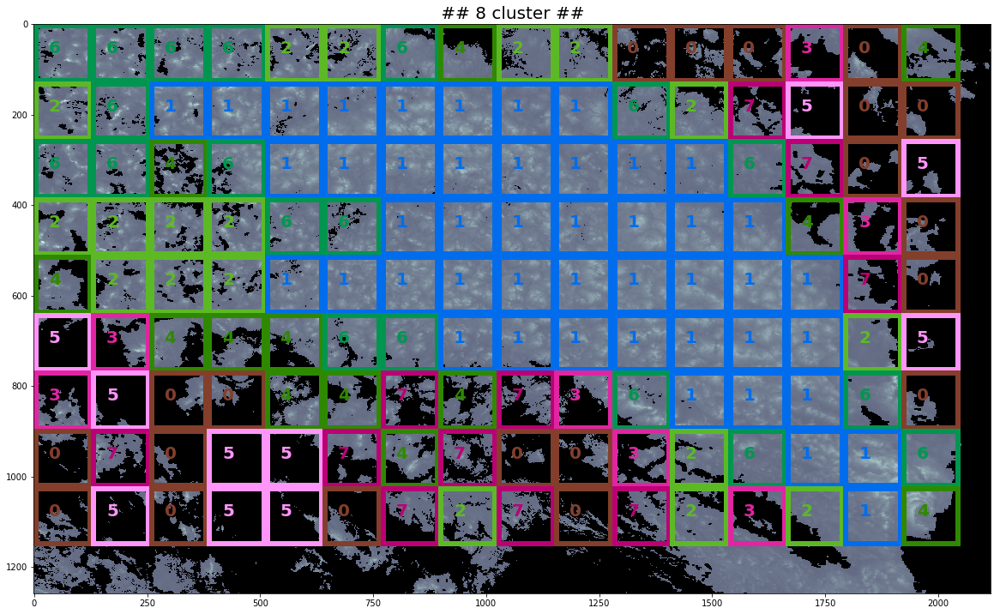

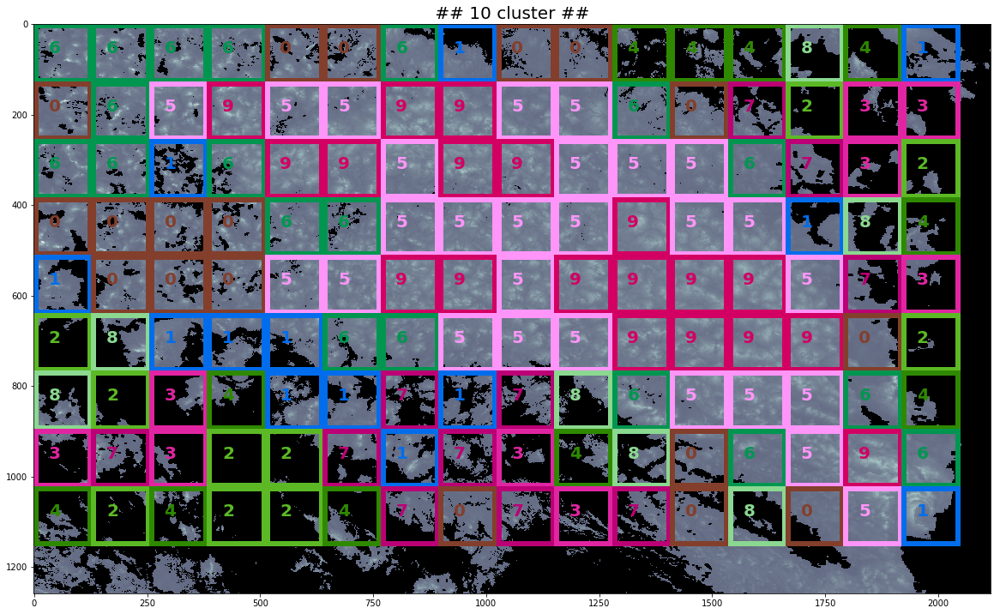

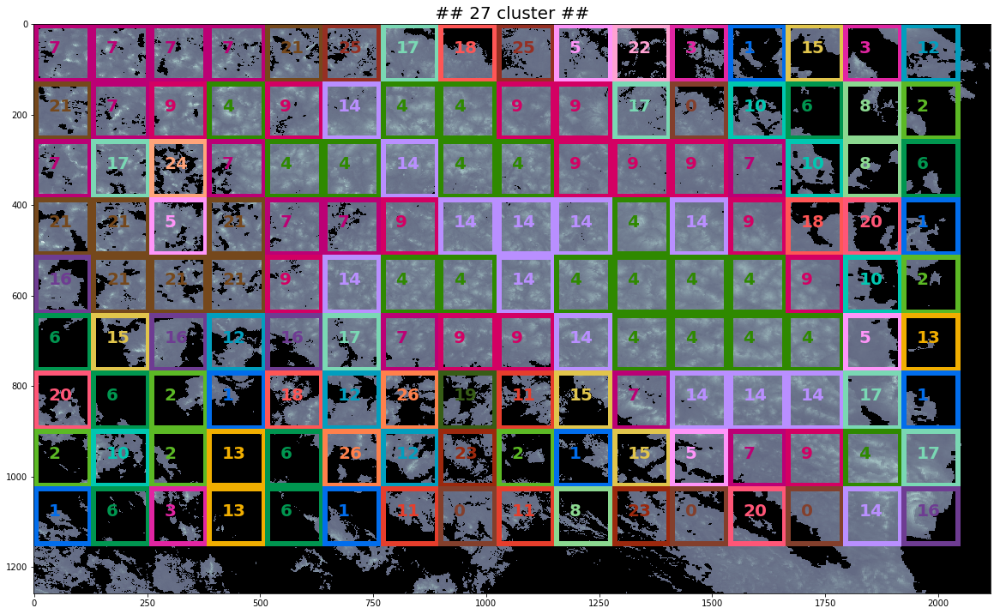

variable : Cloud_Phase_Infrared-Cloud_Phase_Infrared


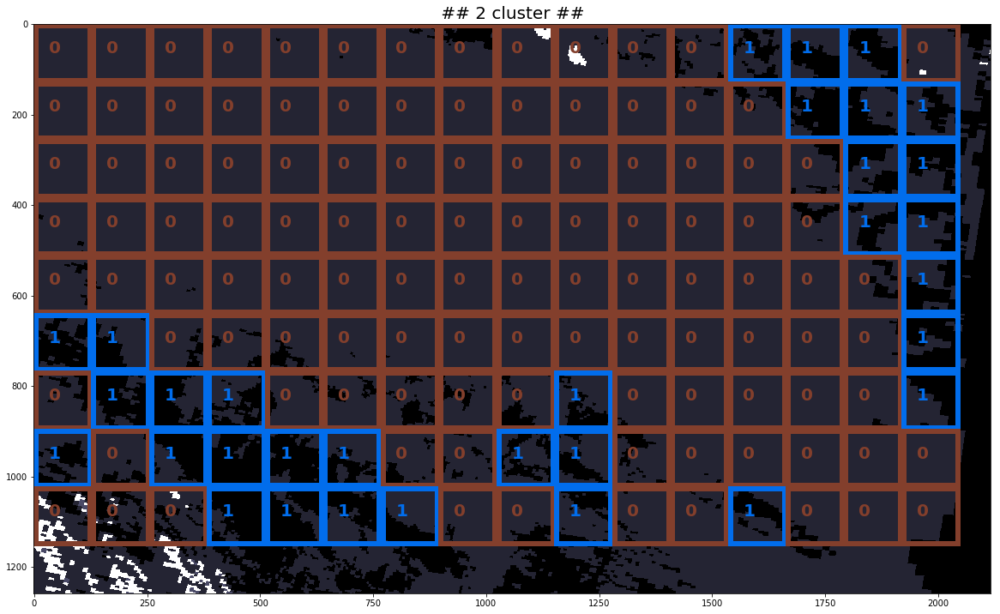

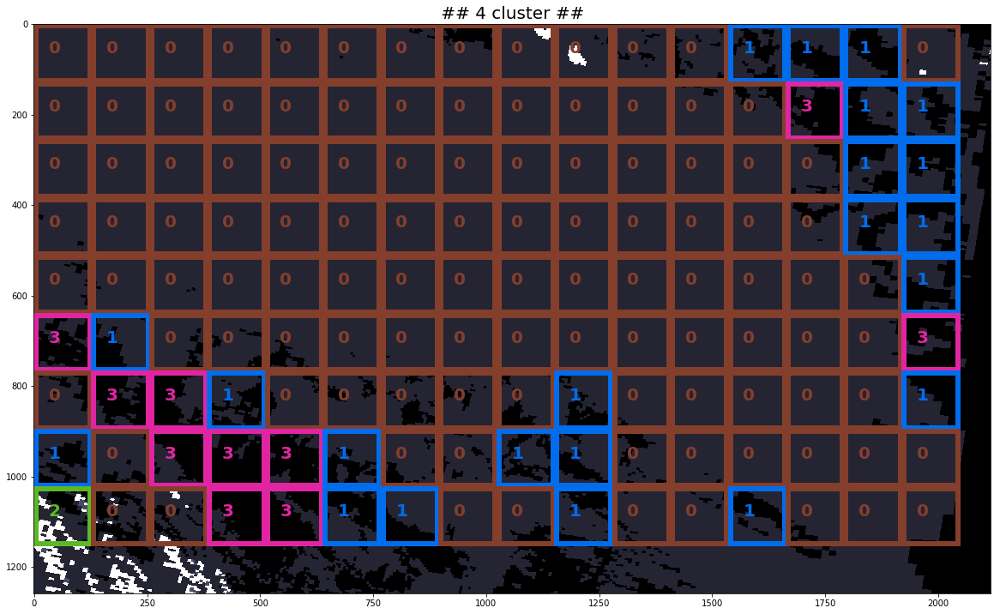

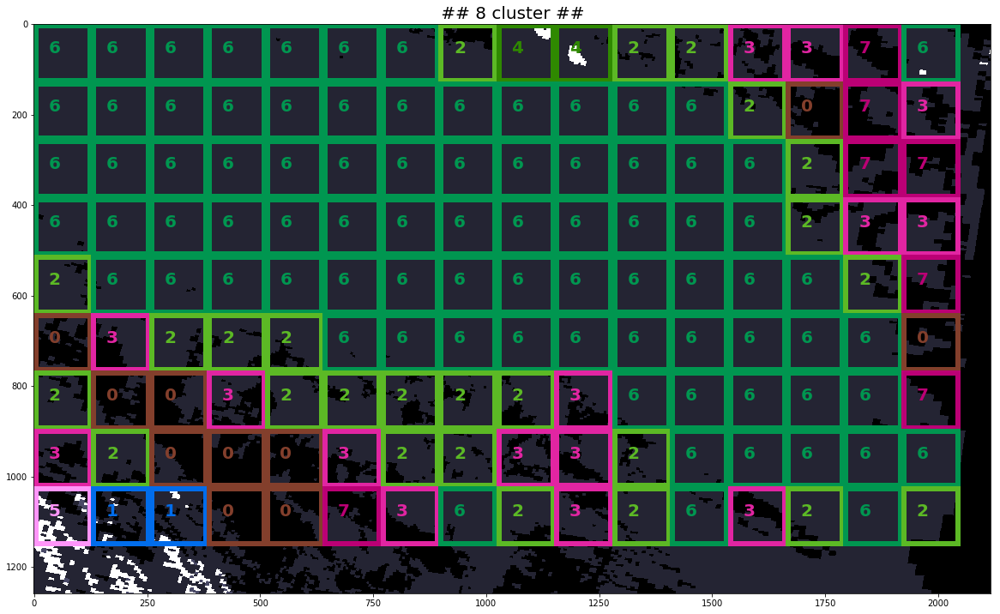

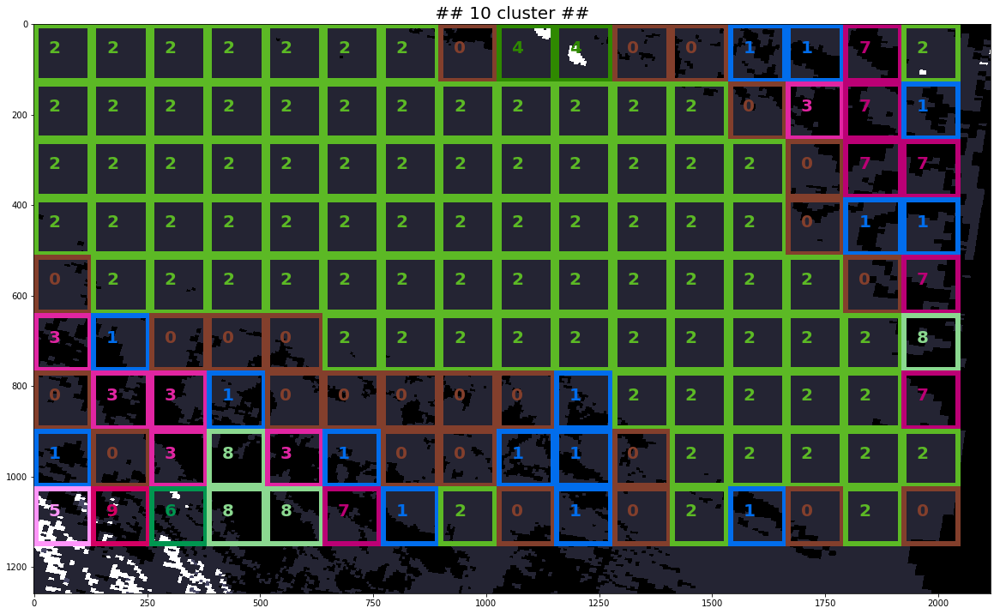

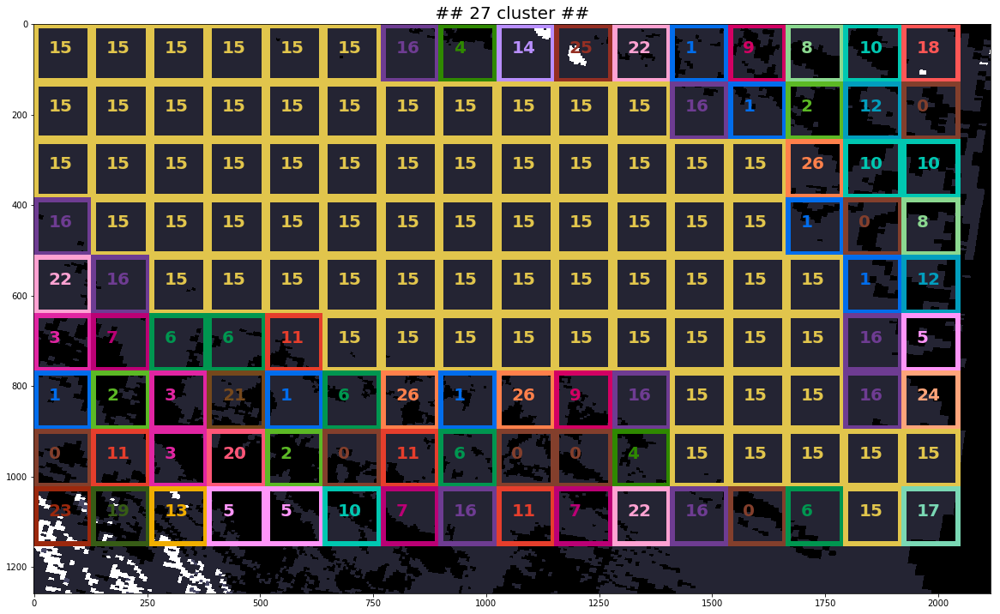

variable : Cloud_Effective_Radius-Cloud_Effective_Radius


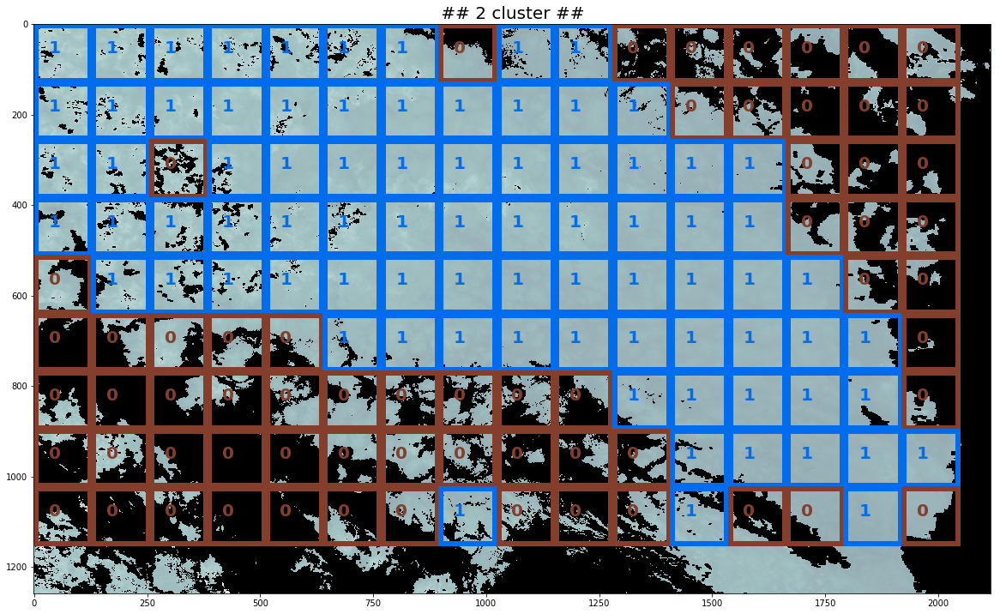

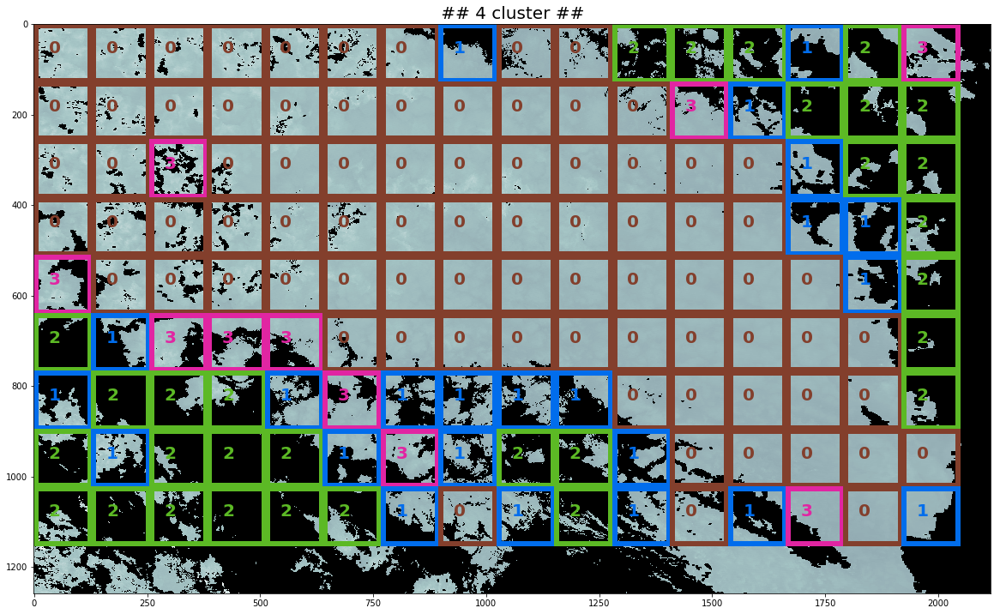

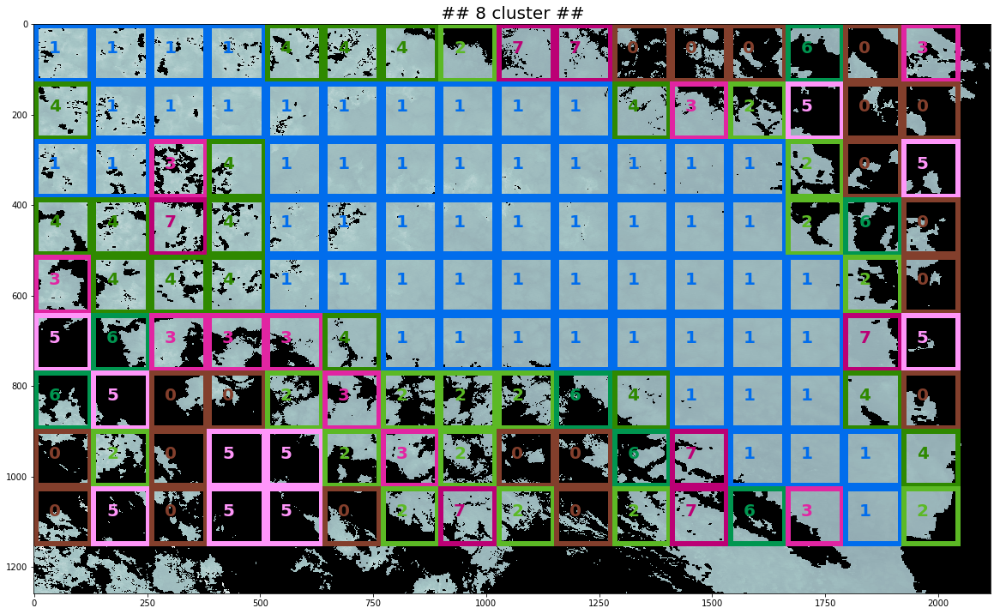

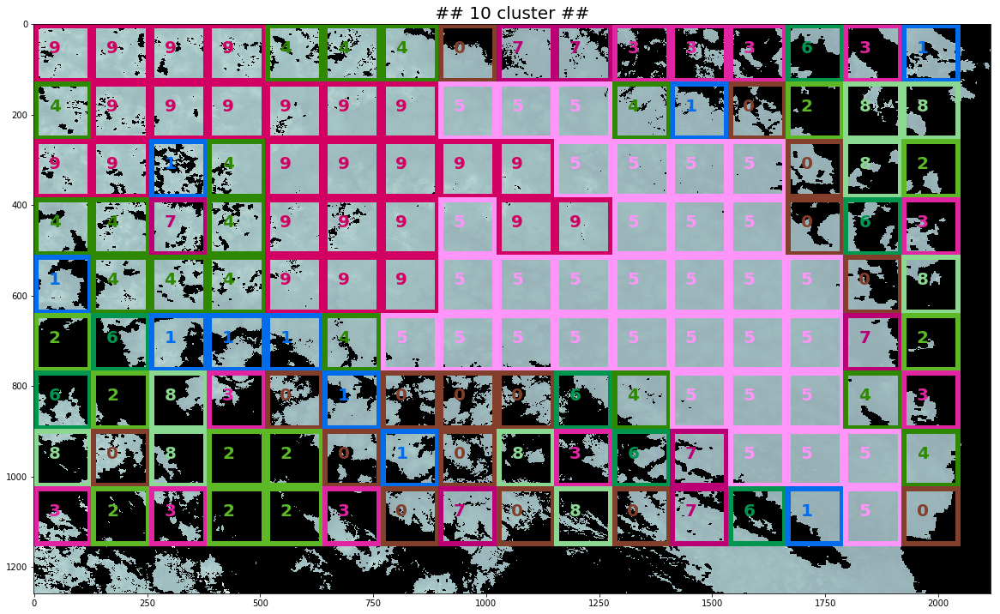

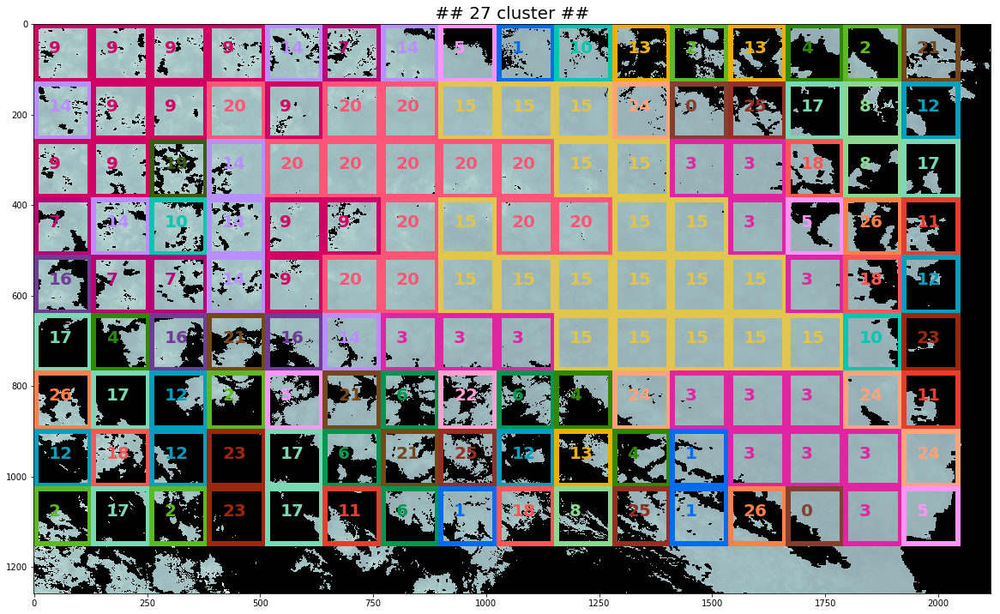

variable : Cloud_Water_Path-Cloud_Water_Path


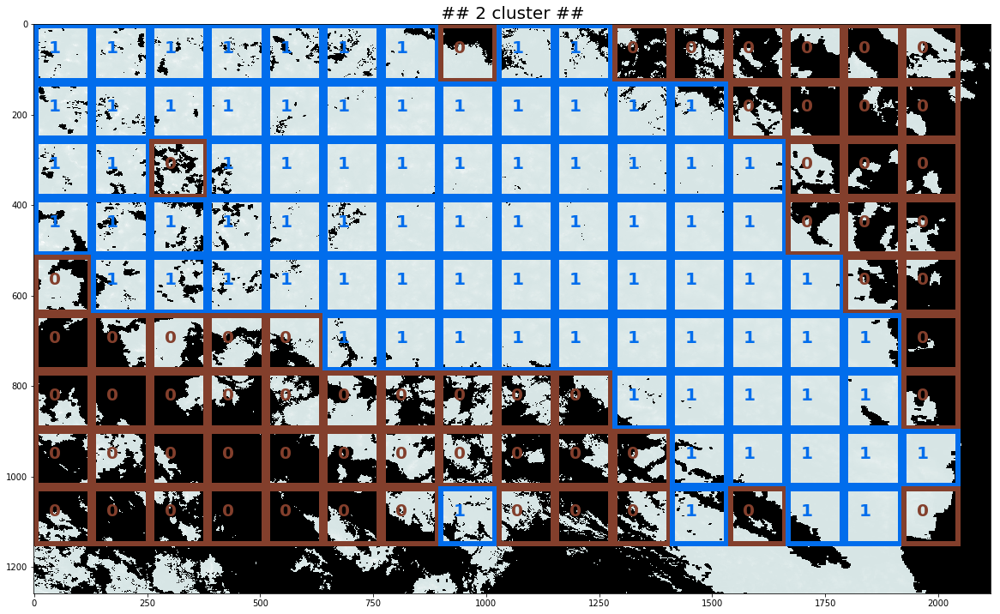

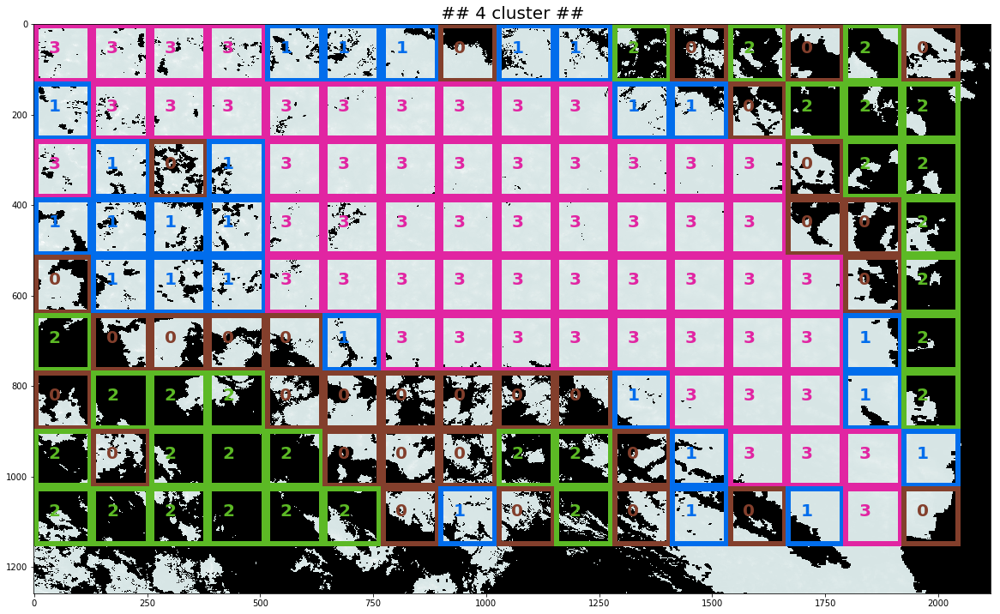

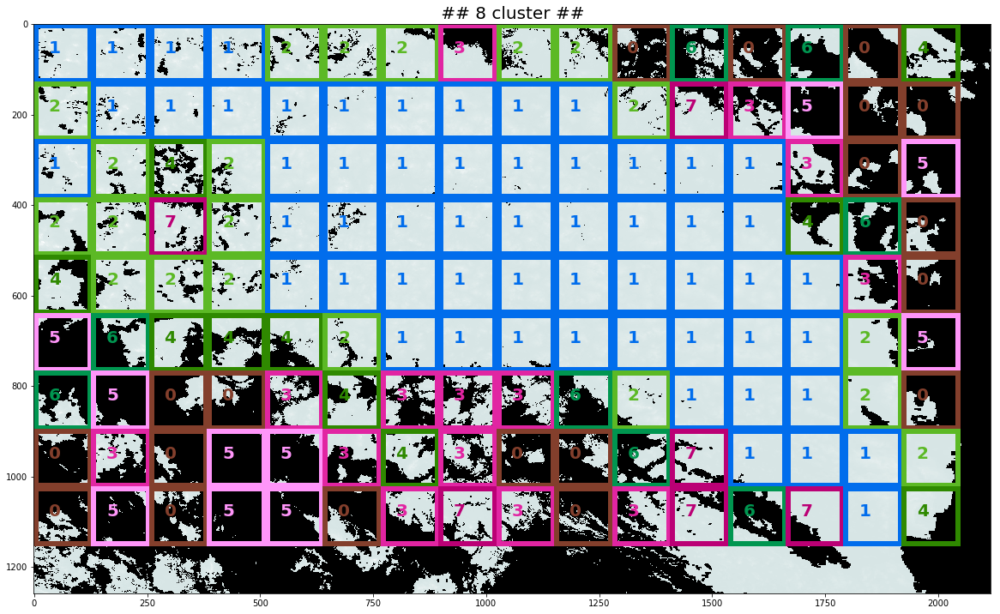

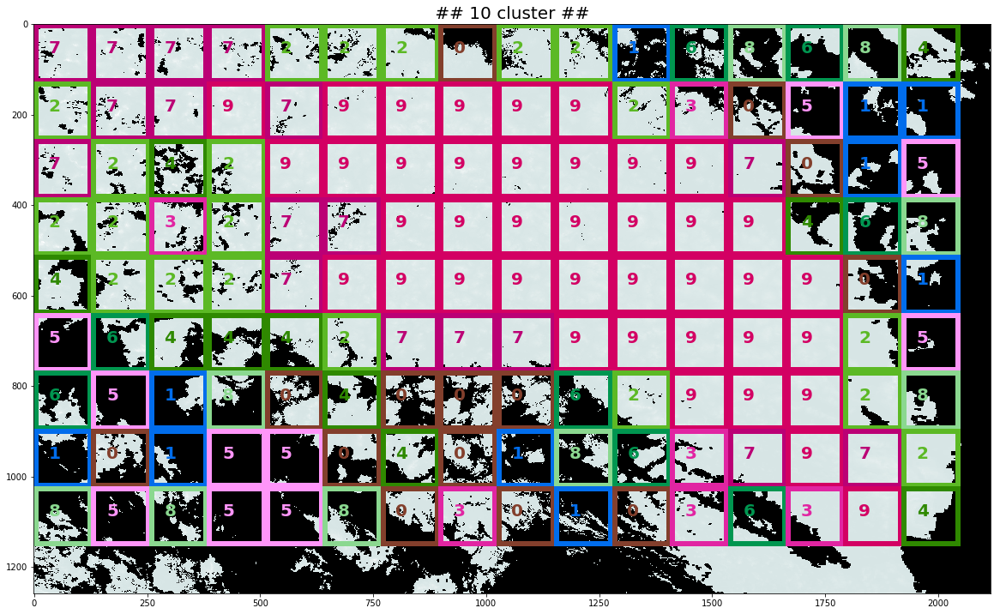

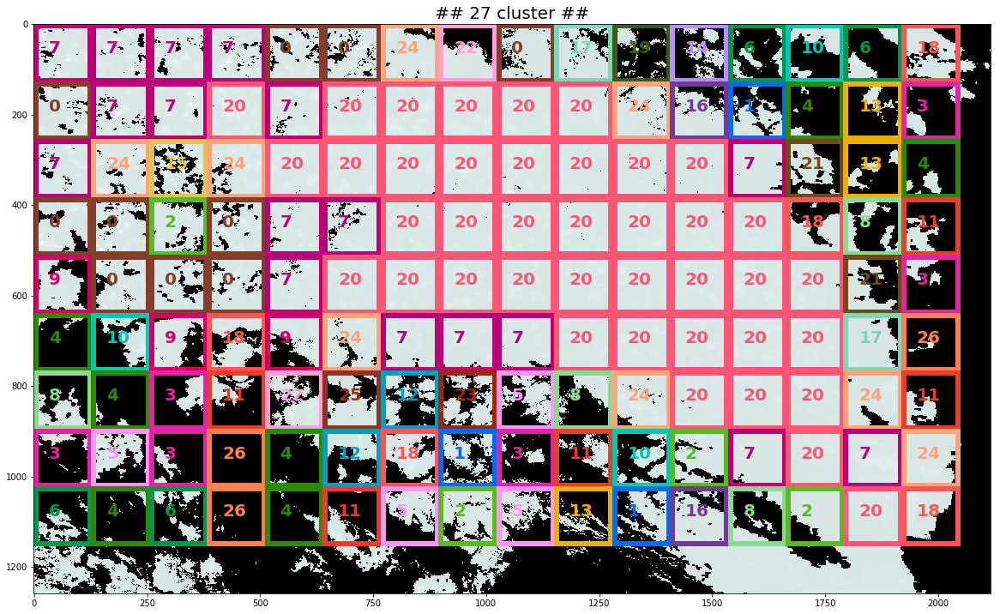

variable : Cirrus_Reflectance-Cirrus_Reflectance


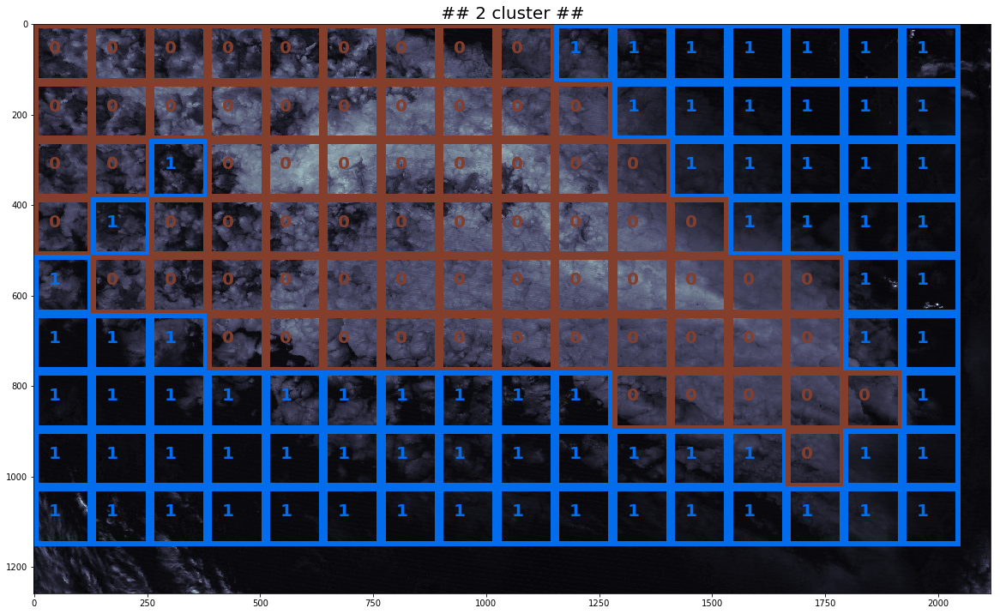

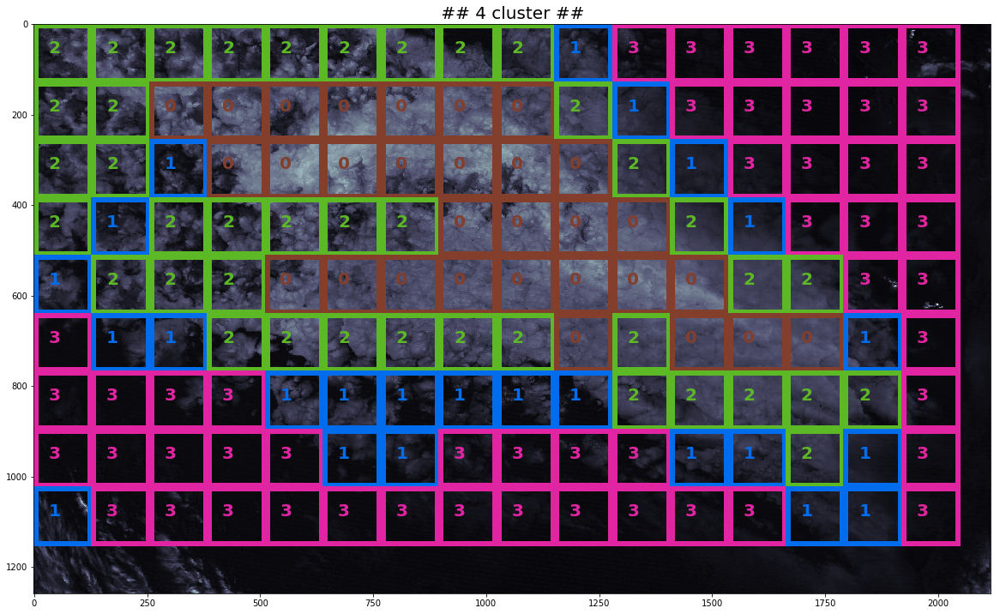

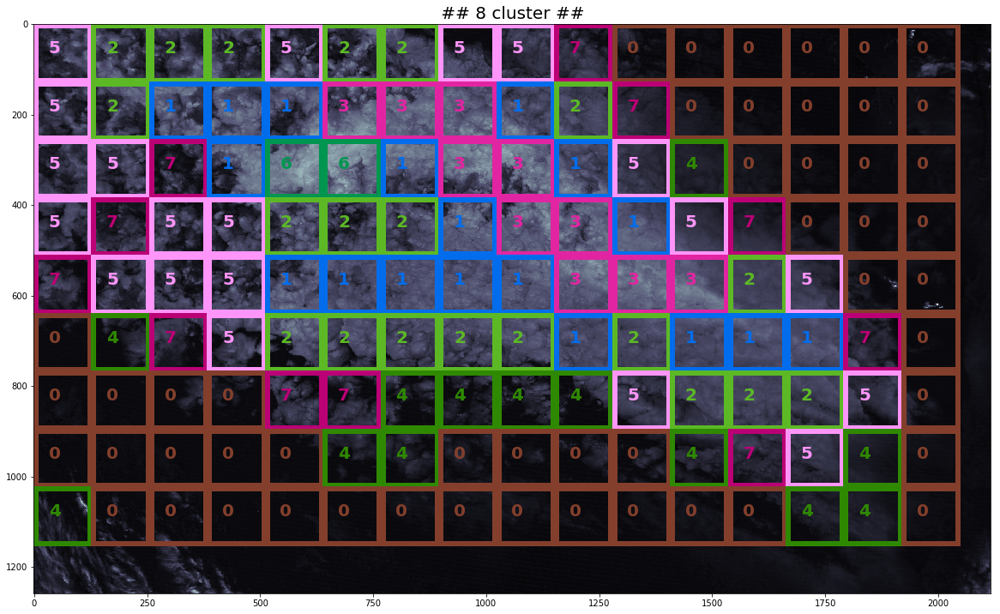

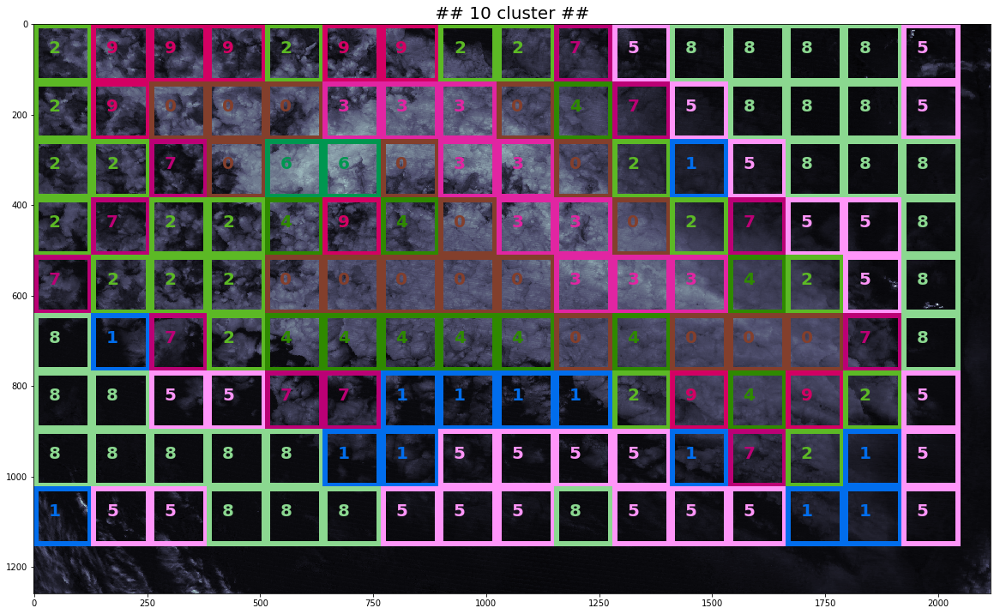

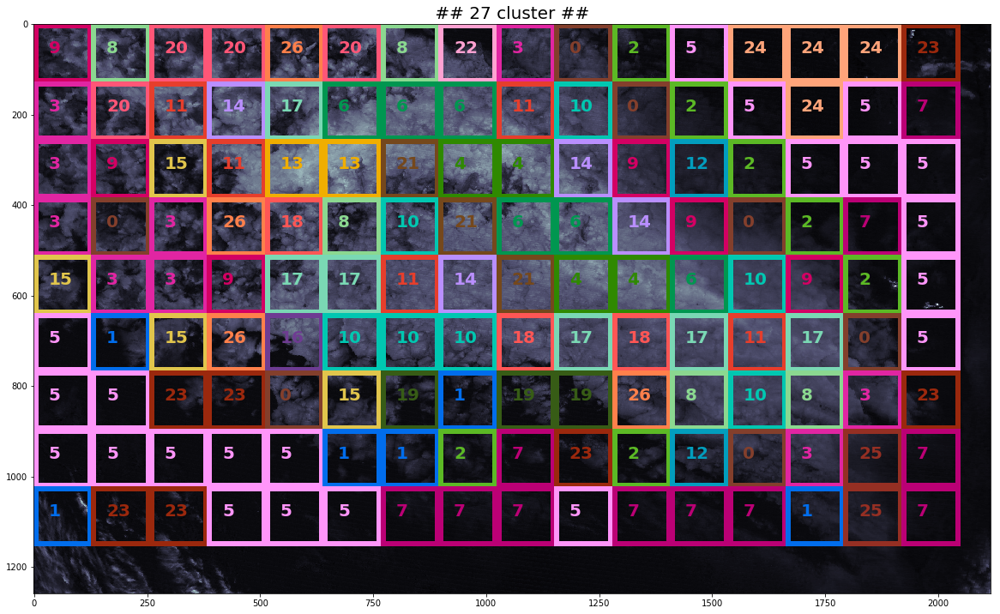

variable : Cloud_Top_Temperature-Cloud_Top_Temperature


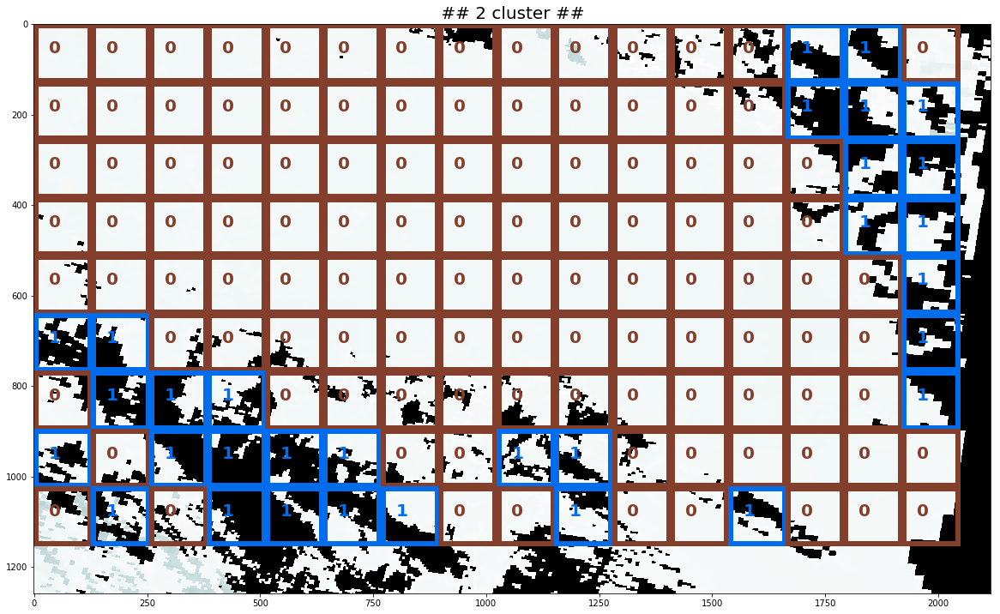

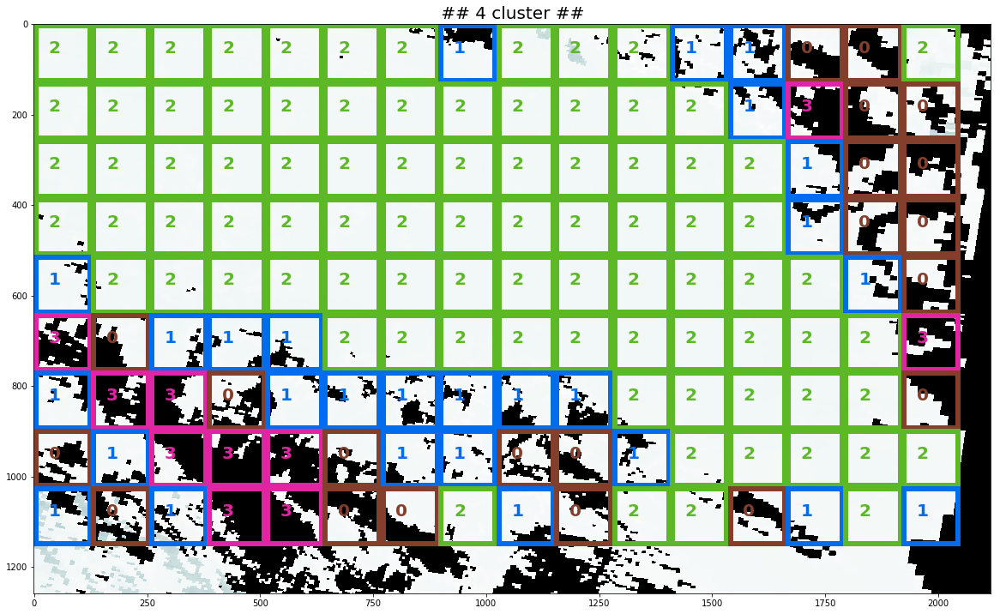

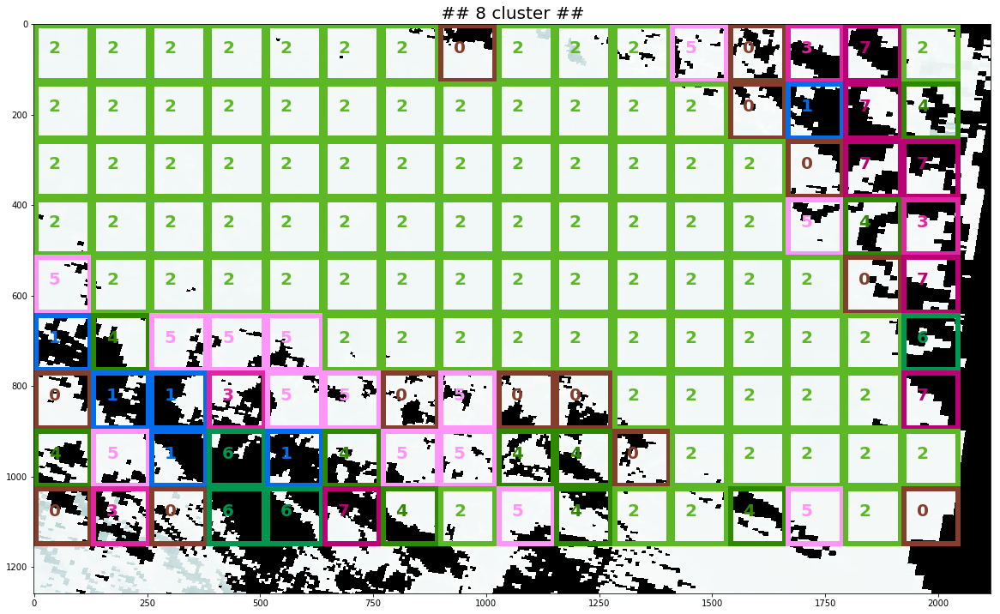

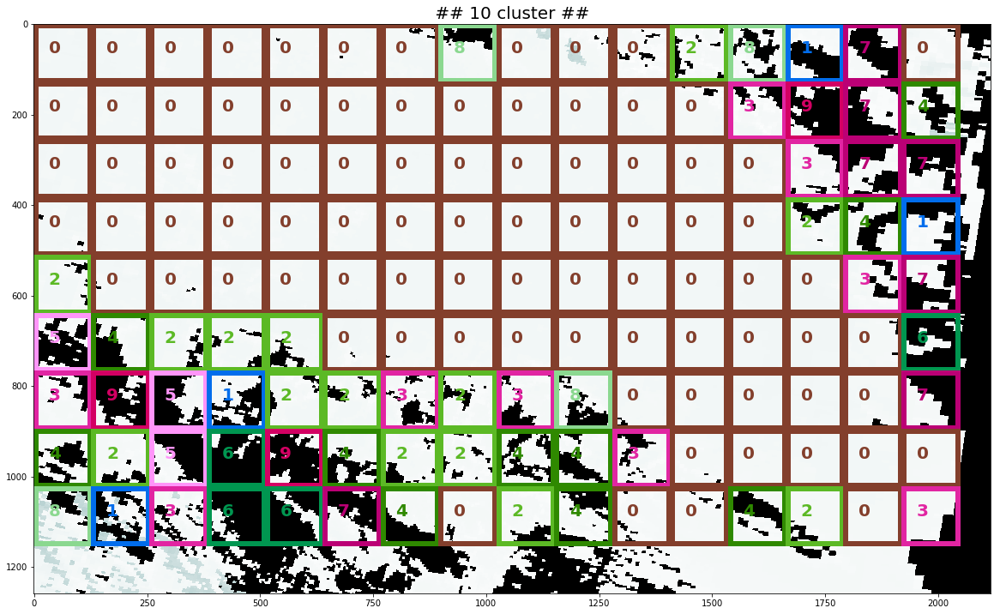

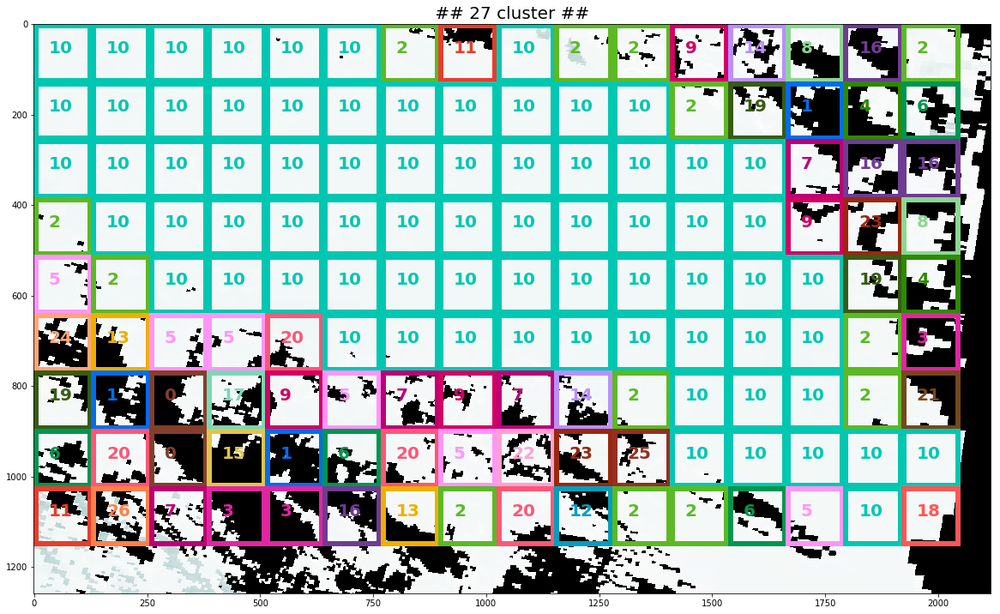

variable : Cloud_Top_Pressure-Cloud_Top_Pressure


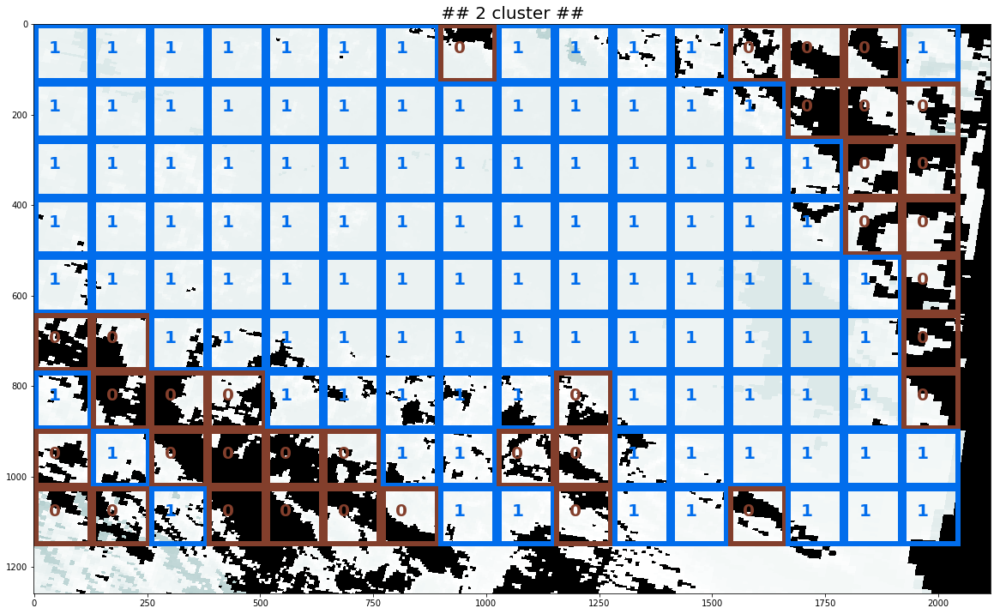

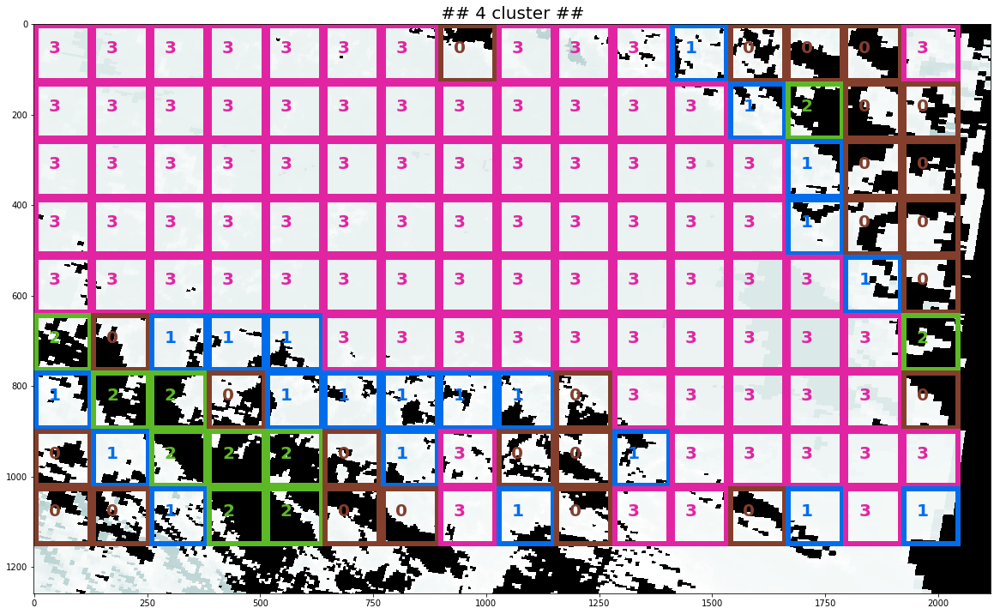

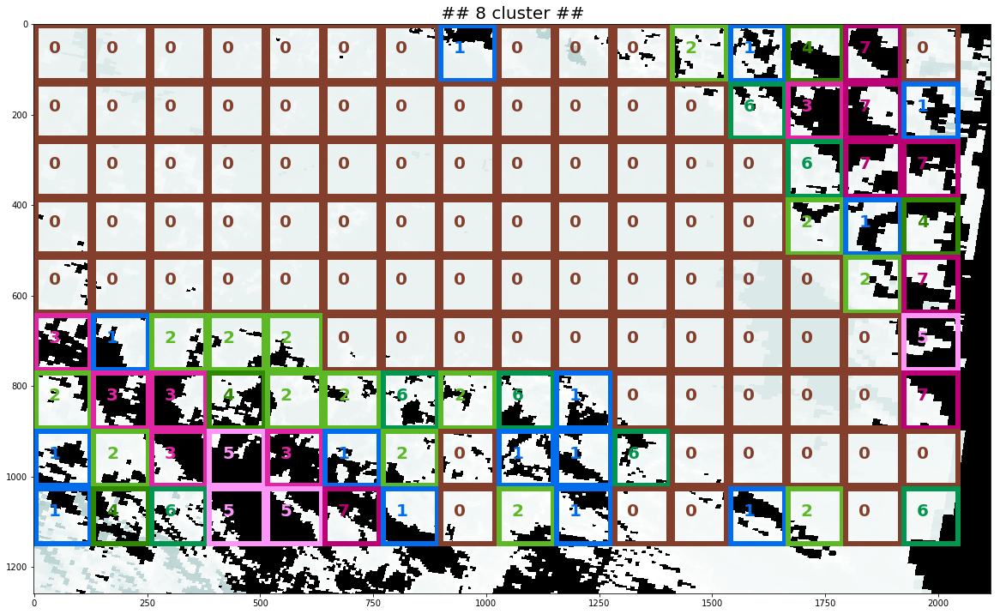

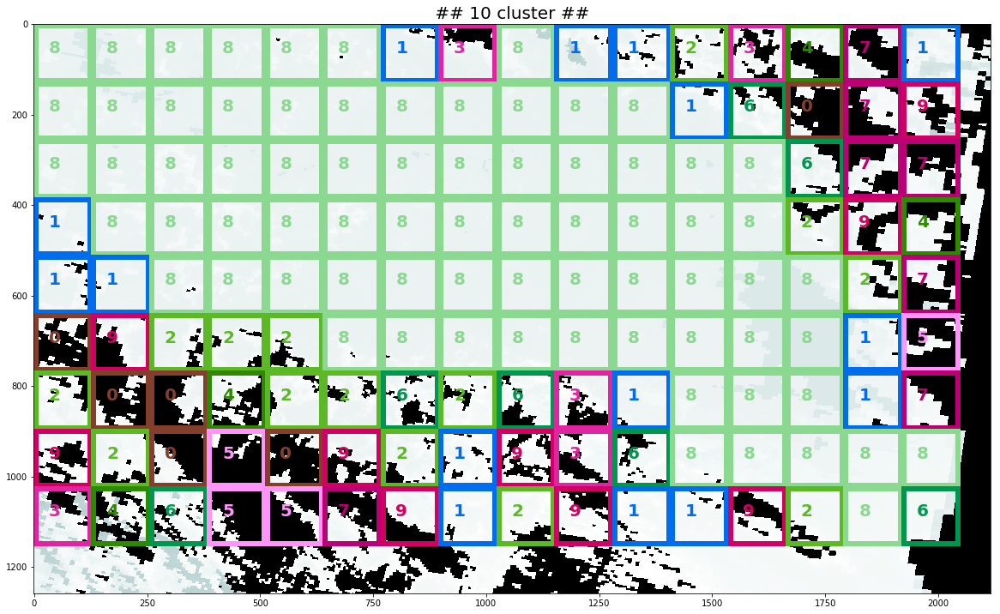

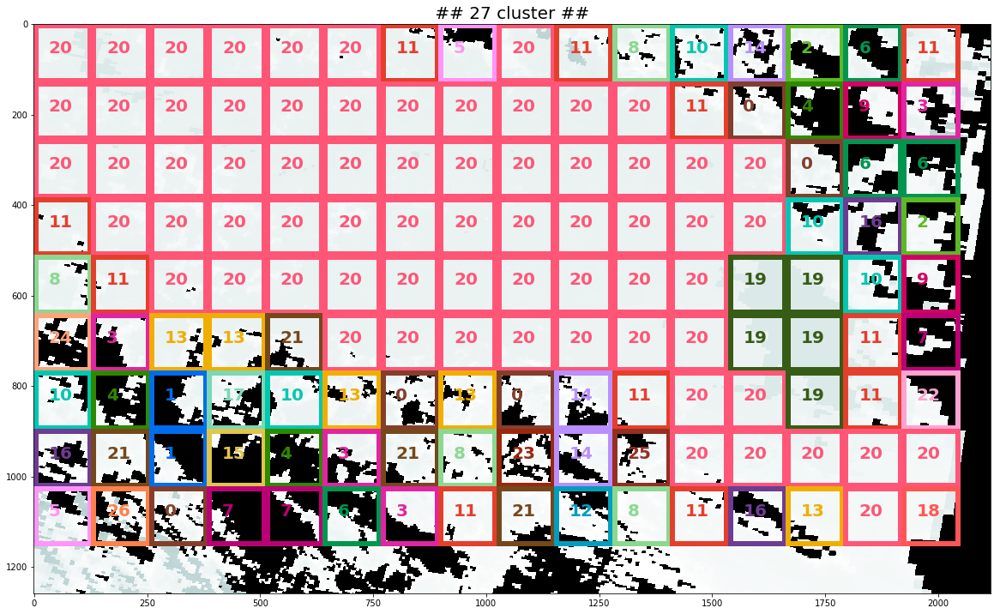

variable : Cloud_Effective_Emissivity-Cloud_Effective_Emissivity


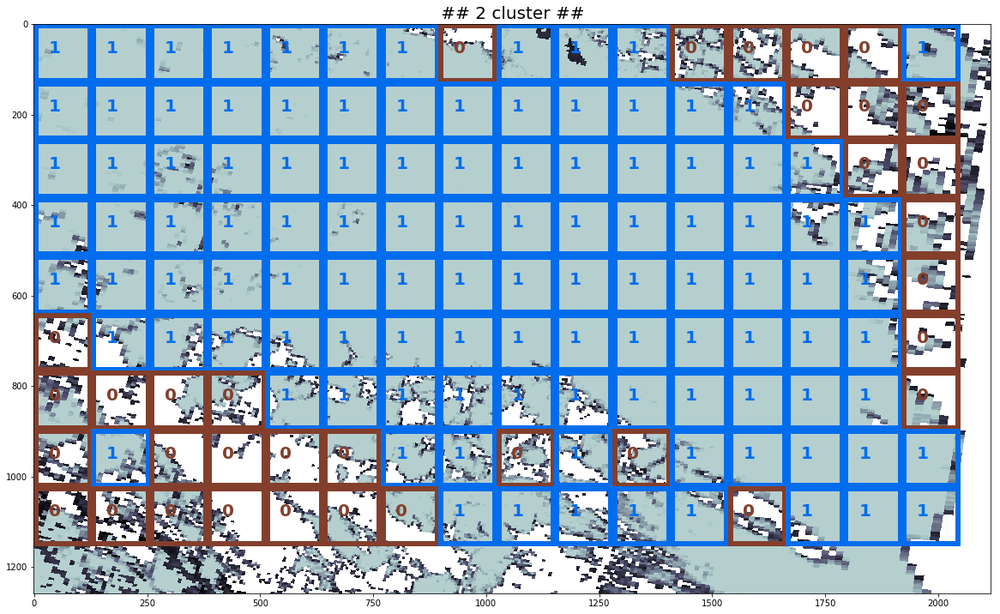

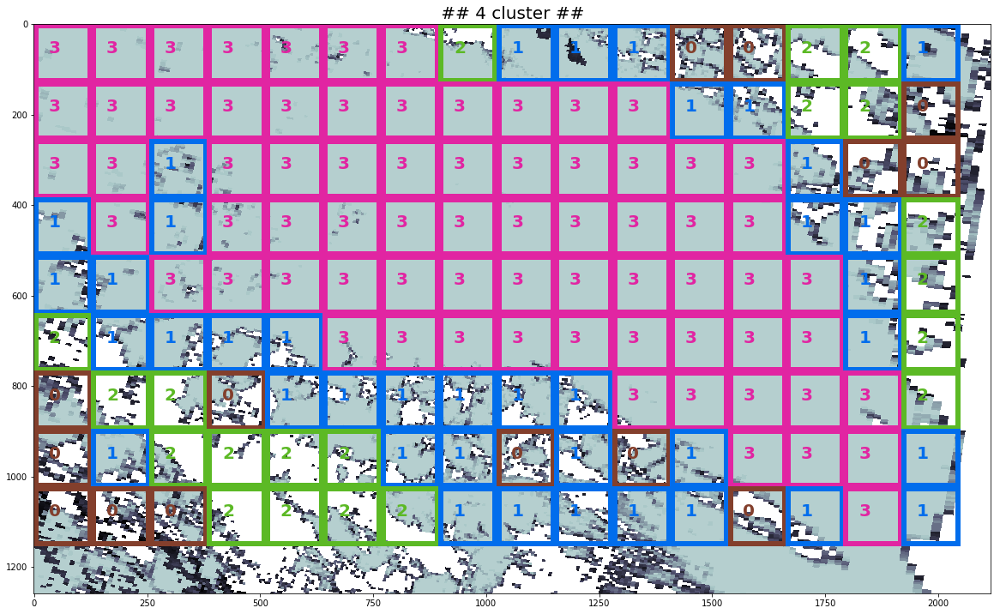

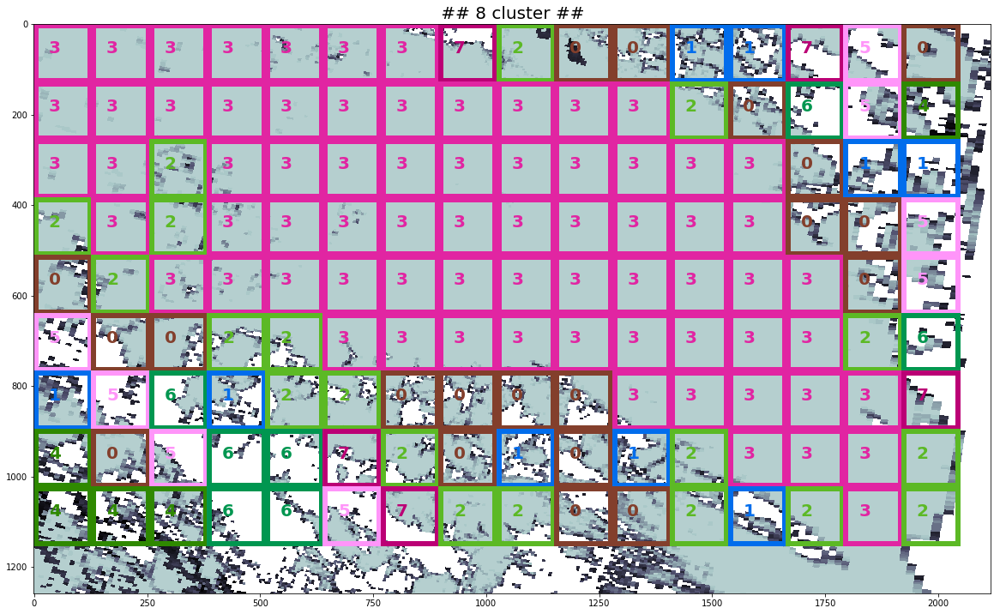

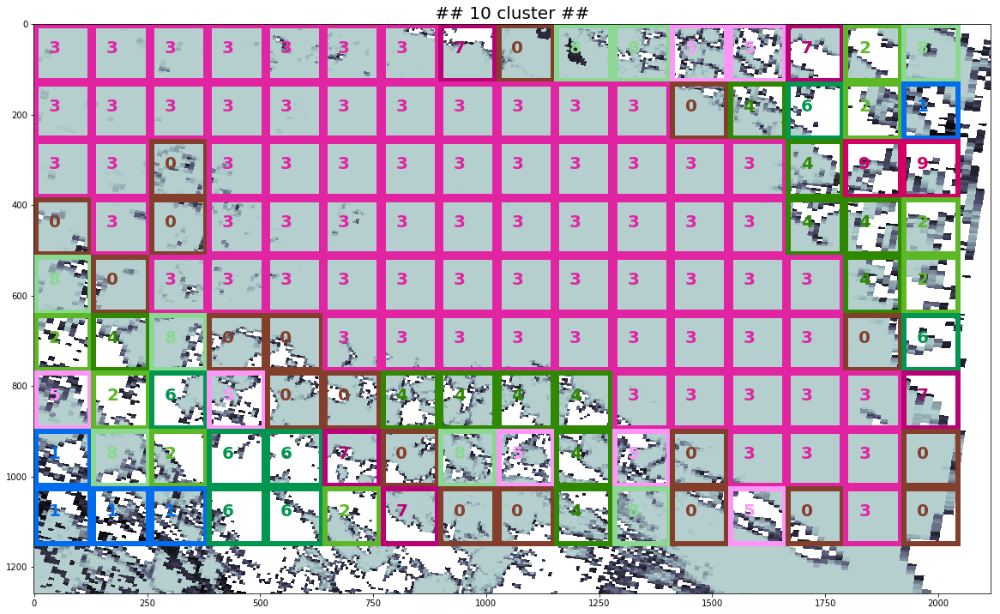

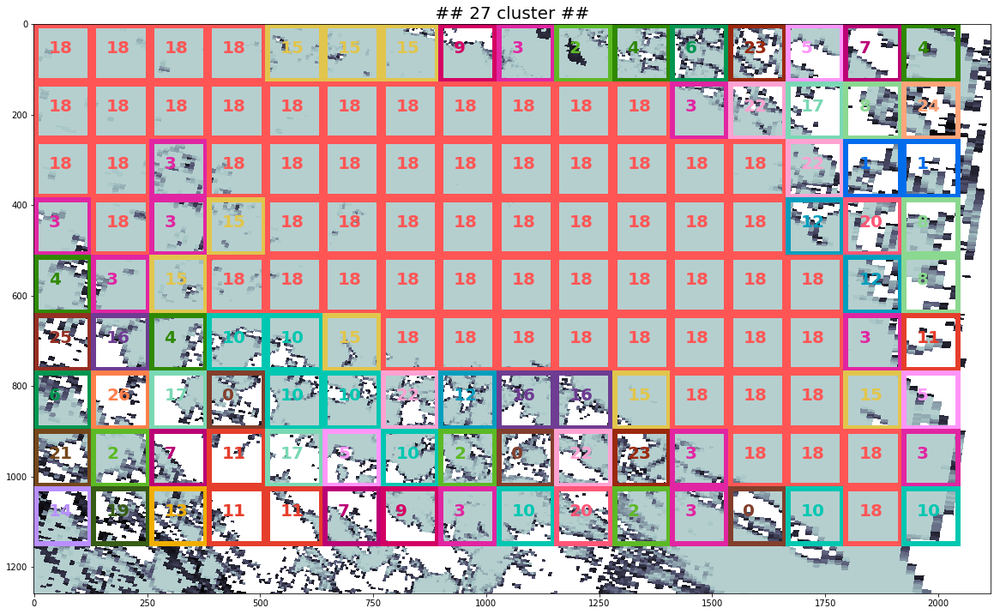

variable : Cloud_Top_Height-Cloud_Top_Height


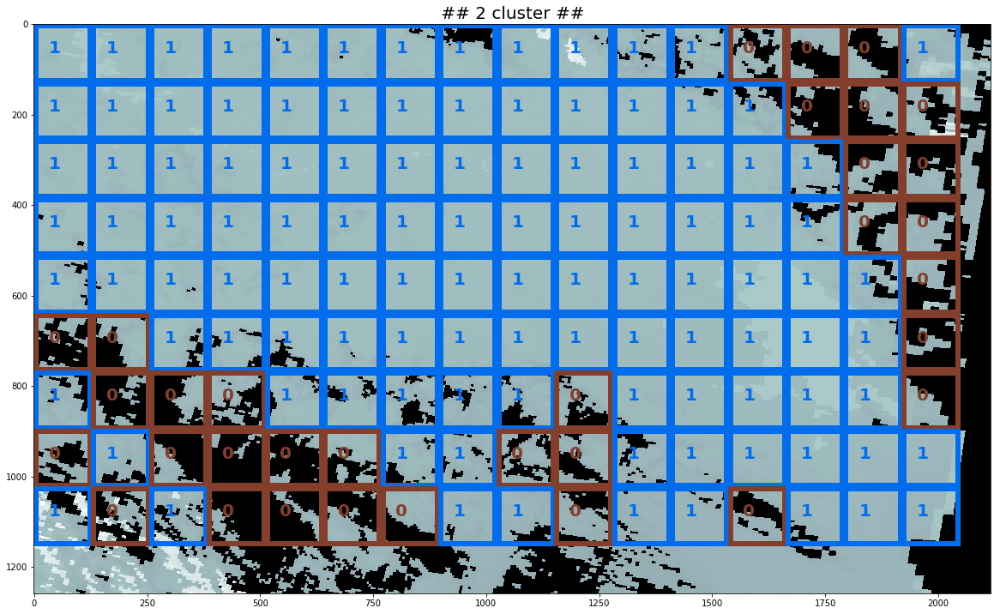

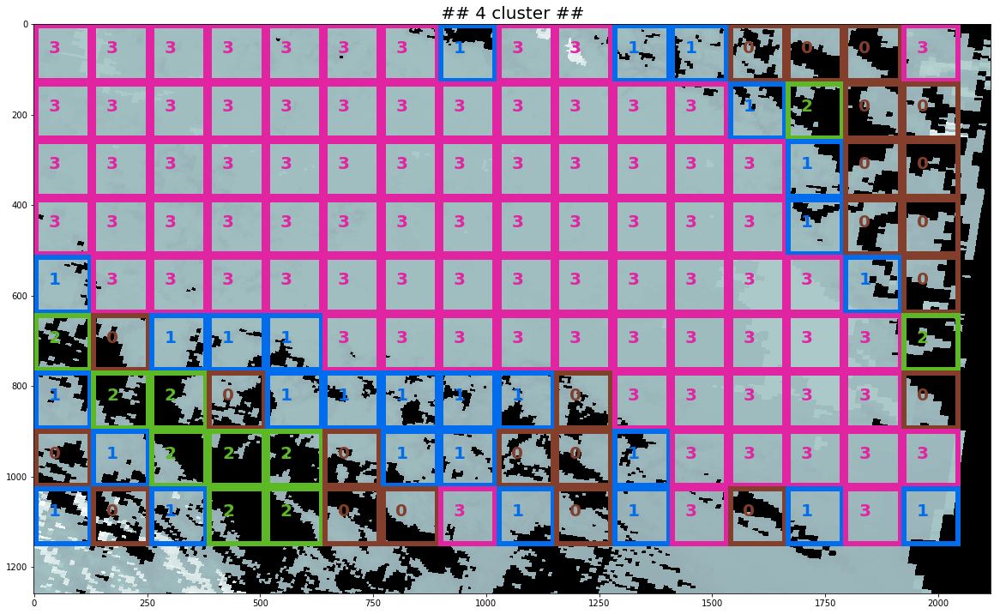

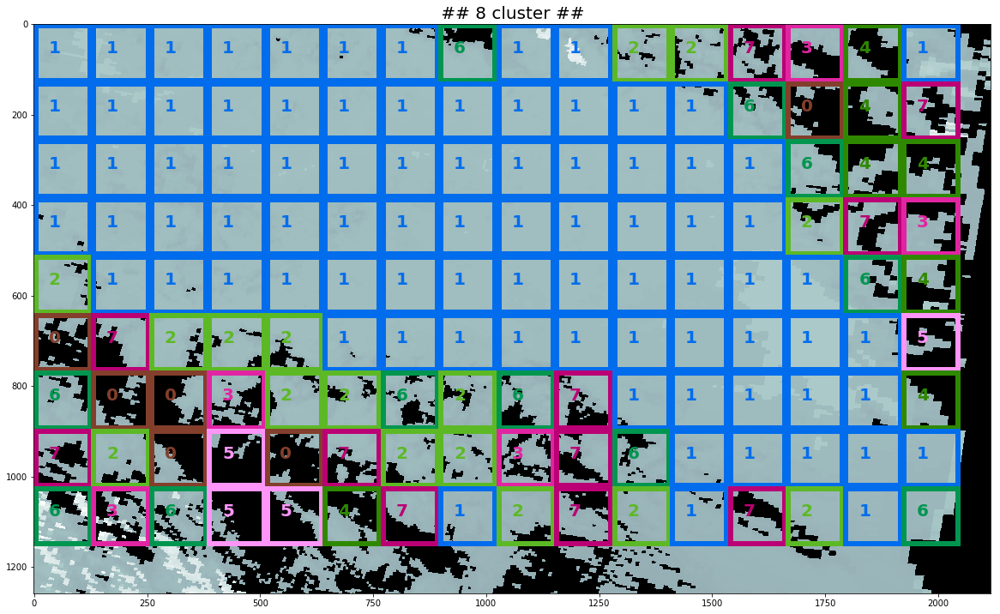

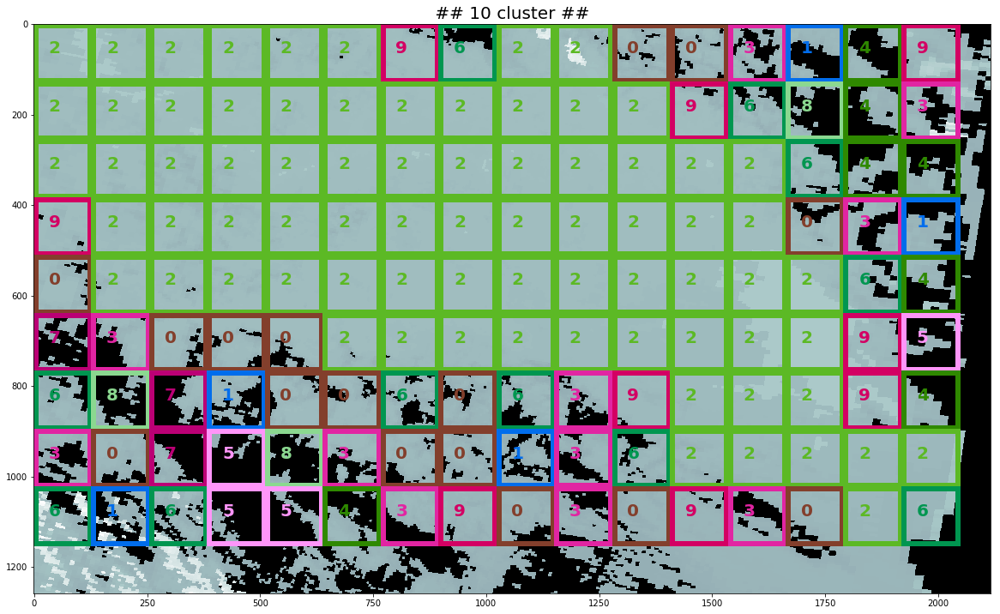

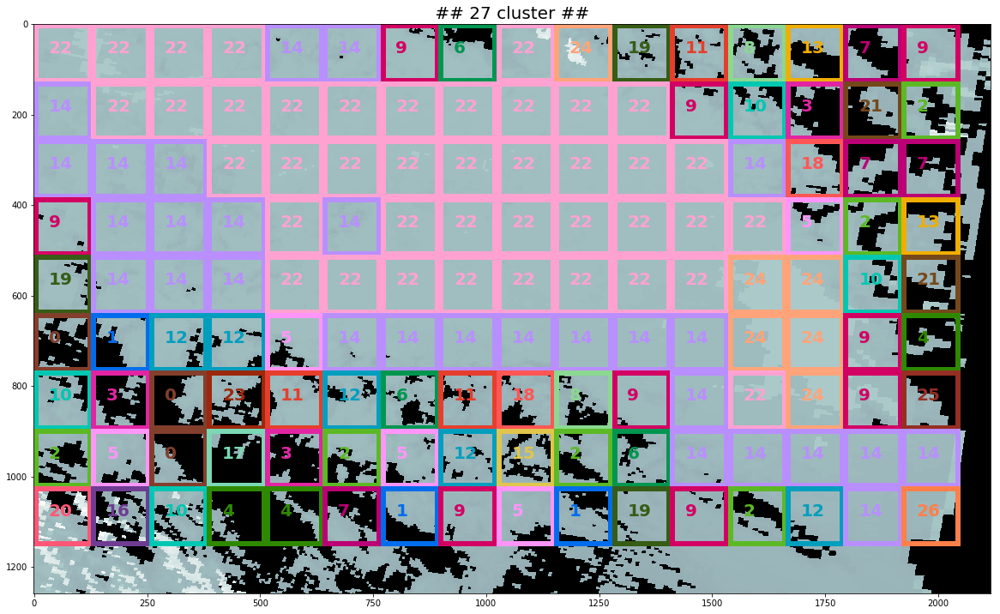

In [70]:
for ifile in filelist:
    _data = _load_tif_data(ifile)
    _data = _data.reshape(_data.shape[0], _data.shape[1], 1)
    data_array = _concatenate(_data)
    #print(data_array.shape)
    patches = _gen_patches(data_array)
    for icluster in [2,4,8,10,27]:
        _patches_labels = _anl_agl(encoder, patches, clusters=icluster)
        cluster_plotting(data_array, patches,_patches_labels, SHAPE, colors, ncluster=icluster)

In [63]:
filelist

['Cloud_Optical_Thickness-Cloud_Optical_Thickness',
 'Cloud_Phase_Infrared-Cloud_Phase_Infrared',
 'Cloud_Effective_Radius-Cloud_Effective_Radius',
 'Cloud_Water_Path-Cloud_Water_Path',
 'Cirrus_Reflectance-Cirrus_Reflectance',
 'Cloud_Top_Temperature-Cloud_Top_Temperature',
 'Cloud_Top_Pressure-Cloud_Top_Pressure',
 'Cloud_Effective_Emissivity-Cloud_Effective_Emissivity',
 'Cloud_Top_Height-Cloud_Top_Height']